In [1]:
# Breast Cancer Detection from Ultrasound Images using Residual unet and its differential analysis using rectangle box approach using open cv libraries

❓ **About the problem** <br>
❤ Breast cancer is the most diagnosed cancer among women worldwide, accounting for 1 in 4 cancer cases.<br>
❤ Breast cancer cells usually form a tumour that can often be seen on an x-ray or felt as a lump.

📔**Introduction** <br>

The goal of **semantic image segmentation** is to label each pixel of an image with a corresponding class of what is being represented. Because we’re predicting for every pixel in the image, this task is commonly referred to as *dense prediction*.
The **output** itself is a high resolution image (typically of the same size as input image) in which each pixel is classified to a particular class.<br>

🗒 About the datset

The data collected at baseline include breast ultrasound images among women in ages between 25 and 75 years old. This data was collected in 2018. The number of patients is 600 female patients. The dataset consists of 780 images with an average image size of 500*500 pixels. The images are in PNG format. The ground truth images are presented with original images. The images are categorized into three classes, which are normal, benign, and malignant.

↪ Dataset Link : [Breast Ultrasound Image Dataset](https://www.kaggle.com/datasets/aryashah2k/breast-ultrasound-images-dataset)

**Step 1: Import Libraries**

In [2]:
import os
import sys
import random

import numpy as np
import pandas as pd
import tensorflow as tf


import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2

from PIL import Image
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from keras import layers
from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.optimizers import SGD, schedules, Adam
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D
from keras.layers.merge import concatenate, add
from keras.models import Model, load_model
from tensorflow.python.keras import losses

from keras import backend as K

In [3]:
from __future__ import print_function

import glob
from skimage.io import imsave
from keras.models import Model
from keras.layers import Lambda, Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose, UpSampling2D ,BatchNormalization, Add, Activation
from tensorflow.keras.optimizers import Adam, Adadelta
from keras.layers.merge import add,multiply
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
# import tensorflow.keras.backend as K
import matplotlib.pyplot as plt
#from data import load_train_data, load_test_data
from sklearn.model_selection import train_test_split
K.set_image_data_format('channels_last')  # TF dimension ordering in this code


img_rows = 256
img_cols = 256
smooth = 1.

In [4]:
!pip install imutils

  Preparing metadata (setup.py) ... done
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25860 sha256=8fb582d28b54cdce4858d4b0a6a9618d6cb2486384cae00af34aa92fa1508263
  Stored in directory: /root/.cache/pip/wheels/86/d7/0a/4923351ed1cec5d5e24c1eaf8905567b02a0343b24aa873df2
Successfully built imutils


In [5]:
import glob
import cv2
# import the necessary packages
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import matplotlib.pyplot as plt
import numpy as np
import imutils
import os
import pandas as pd

In [6]:
from PIL import Image

In [7]:
from __future__ import print_function

import os, glob
from skimage.io import imsave
import numpy as np
from keras.models import Model
from keras.layers import Input, concatenate, Conv2D, Add, MaxPooling2D, Activation, Dense, Reshape, GlobalAveragePooling2D, Multiply, Conv2DTranspose, BatchNormalization
from tensorflow.keras.optimizers import Adam, Adadelta
from keras.callbacks import ModelCheckpoint
from keras import backend as K
#from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
#from data import load_train_data, load_test_data
from sklearn.model_selection import train_test_split
K.set_image_data_format('channels_last')  # TF dimension ordering in this code

**Step 2: Load Dataset**

In [8]:
image_height = 256
image_width = 256
dpath = "../input/breast-ultrasound-images-dataset/Dataset_BUSI_with_GT/"
classes = ['benign', 'malignant', 'normal']

In [9]:
data = {'image' : [],
        'mask' : []}

**Step 3: Data Preprocessing**

In [10]:
def load_data(path, data_obj, class_name):
    img_names_list = os.listdir(path+class_name)
    image_names = []
    mask_names = []
    names_truncated = []
    
    for i in range(len(img_names_list)):
        names_truncated.append(img_names_list[i].split(')')[0])
    
    names_truncated = list(set(names_truncated))
    for i in range(len(names_truncated)):
        image_names.append(names_truncated[i]+').png')
        mask_names.append(names_truncated[i]+')_mask.png')
    
    data_obj = preprocess_data(image_names, mask_names, image_width, image_height, path, class_name, data_obj)
        
        
    return data_obj
    

In [11]:
def preprocess_data(image_names, mask_names, img_width, img_height, dpath, dclass, data_obj):
    for index in range (len(image_names)):
#         img = plt.imread(dpath+'/'+dclass+'/'+ image_names[index])
#         mask = plt.imread(dpath+'/'+dclass+'/'+ mask_names[index])

#         img = cv2.resize(img, (img_width, img_height)) 
#         mask = cv2.resize(mask, (img_width, img_height))
        
#         mask = np.expand_dims(mask, -1)

        image_path = dpath+'/'+dclass+'/'+ image_names[index]
        mask_path = dpath+'/'+dclass+'/'+ mask_names[index]
        
        x = cv2.imread(image_path, cv2.IMREAD_COLOR)
        x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)
        x = np.round(cv2.resize(x, (image_height, image_width)))
        x.dtype = np.uint8
        y = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        y = cv2.resize(y, (image_height, image_width))

        x= x/255.0
        y= y/255.0
        data_obj['image'].append(x)
        data_obj['mask'].append(y)

    return data_obj

In [12]:
data = load_data(dpath, data, classes[0]) 
ln = len(data['image'])
print("Number of benign tumor images", ln)
data = load_data(dpath, data, classes[1]) 
print("Number of malignant tumor images", len(data['image'])-ln)
print("Total images for segmentation", len(data['image']))

Number of benign tumor images 437
Number of malignant tumor images 210
Total images for segmentation 647


**Step 5: Visualization**

In [13]:
def visualize_example(data, index = None):
    if index is None:
        index = random.randint(0, len(data['image']))
    X = data['image']
    y = data['mask']
    has_mask = y[index].max() > 0
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(X[index])
    if has_mask:
        ax[0].contour(y[index].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('Image')

    ax[1].imshow(y[index].squeeze())
    ax[1].set_title('Mask')
    #ax[1].savefig(m_out)
    
    # code for save fig only the mask image
    # Save just the portion _inside_ the second axis's boundaries
    #extent = ax[1].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('ax2_figure.png', bbox_inches=extent)

    # Pad the saved area by 10% in the x-direction and 20% in the y-direction
    #fig.savefig('ax2_figure_expanded.png', bbox_inches=extent.expanded(1.1, 1.2))

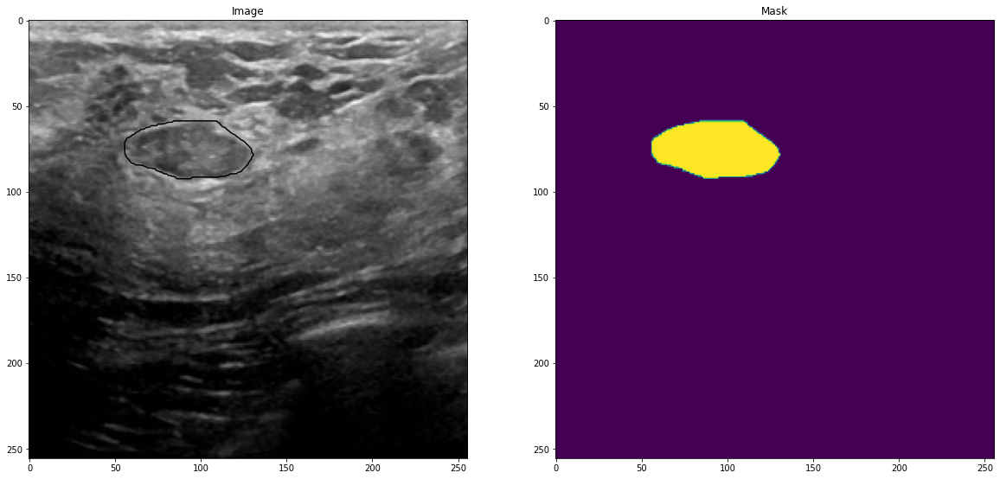

In [14]:
visualize_example(data)

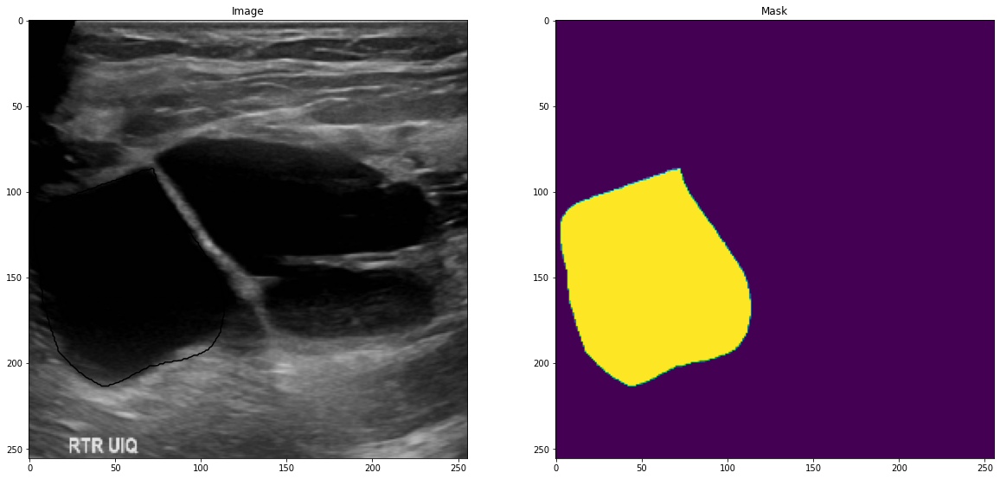

In [15]:
visualize_example(data,index=0)

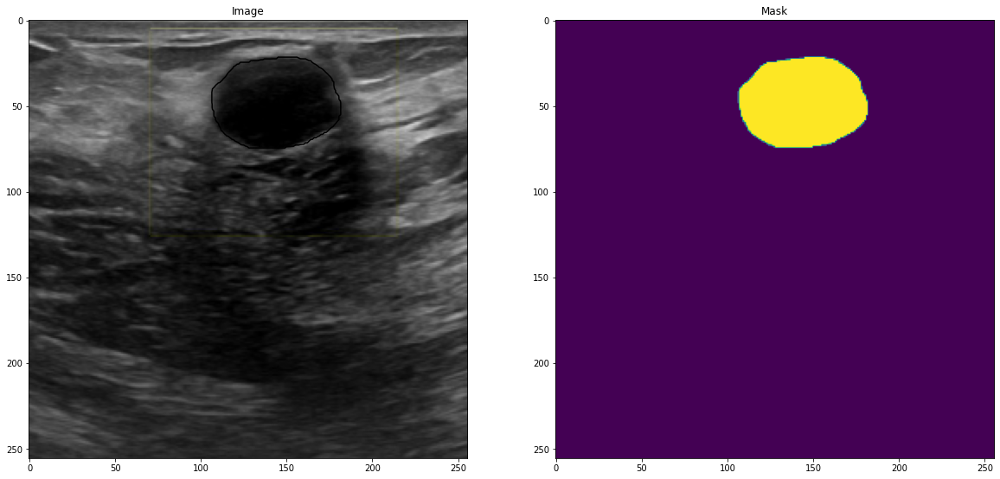

In [16]:
visualize_example(data,index=14)

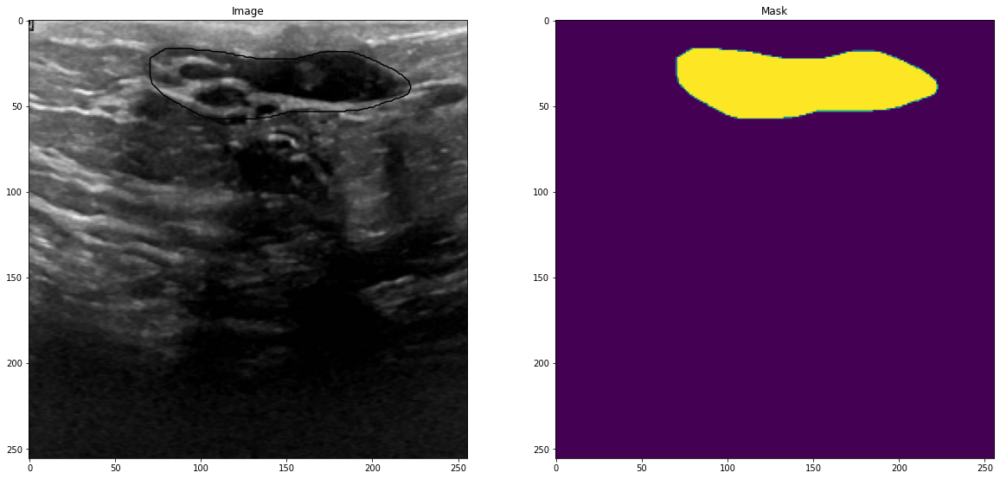

In [17]:
visualize_example(data,index=210)

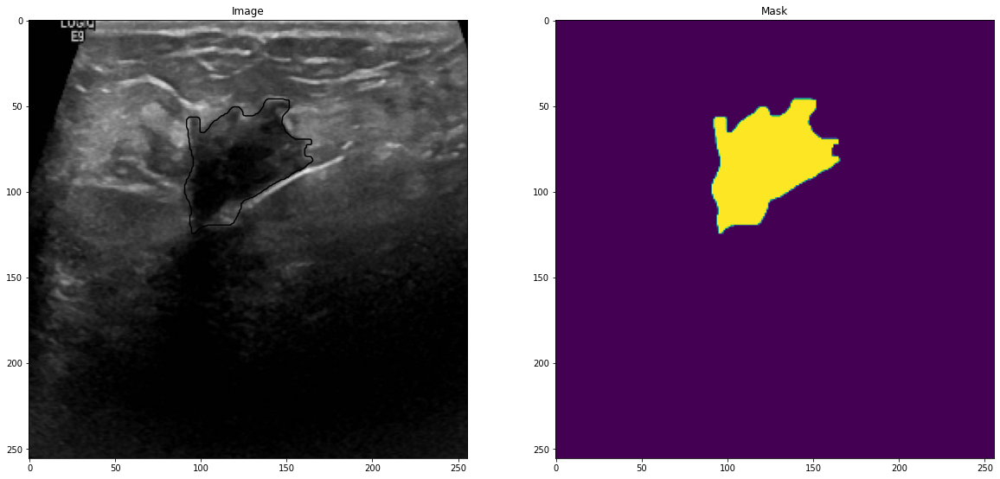

In [18]:
visualize_example(data,index=646)

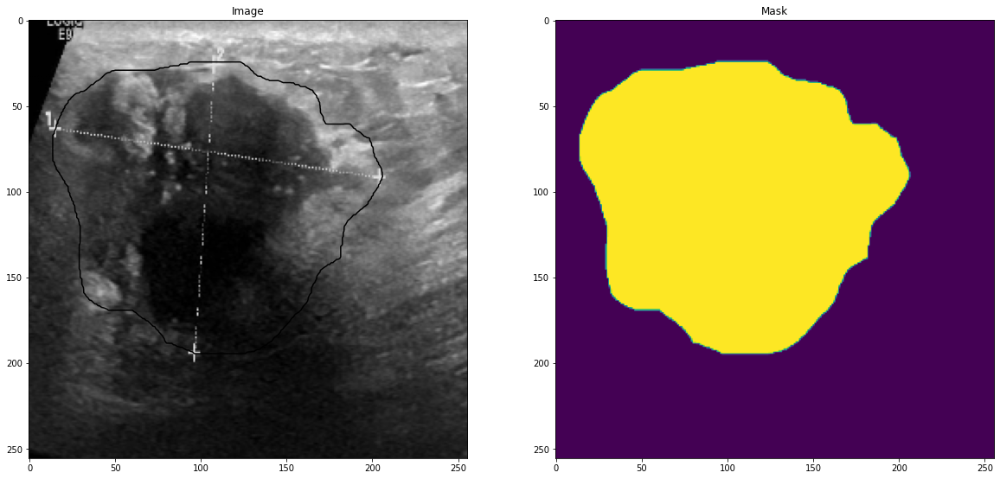

In [19]:
visualize_example(data,index=437)

In [20]:
data['image'] = np.array(data['image'])
data['image'].shape

(647, 256, 256, 3)

In [21]:
data['mask'] = np.array(data['mask'])
data['mask'] =  np.expand_dims(data['mask'], -1)
data['mask'].shape

(647, 256, 256, 1)

**Step 6: Train-Test Split**

In [22]:
# for all images 
X_train, X_valid, y_train, y_valid = train_test_split(data['image'], data['mask'], test_size=0.2, random_state=42)
print(len(X_train), len(y_train), len(X_valid), len(y_valid))

517 517 130 130


**Step 7: Data Augmentation**: Image data augmentation is a technique that can be used to artificially expand the size of a training dataset by creating modified versions of images in the dataset.Since the dataset only includes x images, performing data augmentation helps in preventing a neural network from learning irrelevant features. This results in better model performance.

**a)** Here we have defined a function to perform basic augmentation techniques like rotation, flipping, zooming etc.

In [23]:
data_gen_args = dict(
    rotation_range=60,
    zoom_range=[0.6,1.0],
    horizontal_flip=True,
    vertical_flip = True,
    fill_mode="nearest",
)

**b)** Here we are using the Keras deep learning neural network library that provides the capability to fit models using image data augmentation via the ImageDataGenerator class.

In [24]:
image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)
seed = 1

In [25]:
image_datagen.fit(X_train, augment=True, seed=seed)

In [26]:
mask_datagen.fit(y_train, augment=True, seed=seed)

**Step 8: Fitting and Creating Train Generator**

In [27]:
image_generator = image_datagen.flow(
    X_train,
    batch_size = 16,
    seed=seed)
mask_generator = mask_datagen.flow(
    y_train,
    batch_size = 16,
    seed=seed)

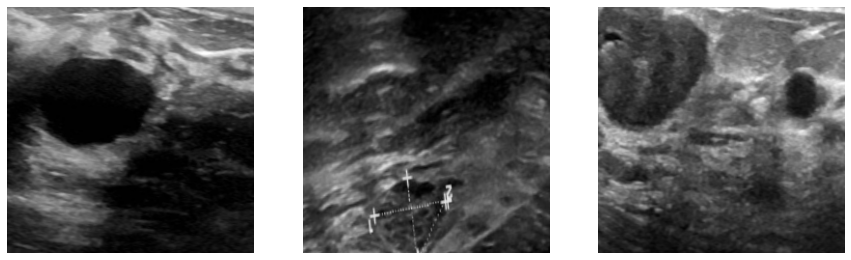

In [28]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(image_generator)[0]
    ax[i].imshow(image)
    ax[i].axis('off')

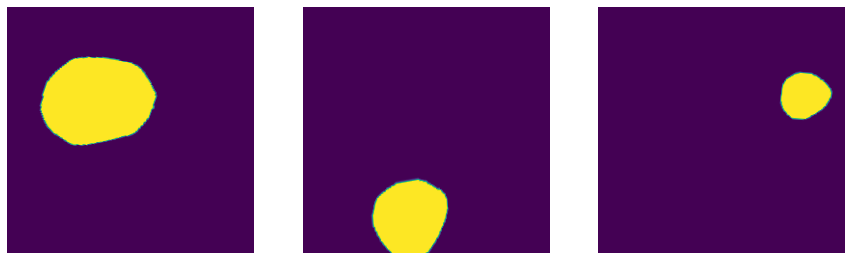

In [29]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(mask_generator)[0]
    #print(image)
    ax[i].imshow(image)
    ax[i].axis('off')
    # Save just the portion _inside_ the second axis's boundaries
    #extent = ax[i].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('axi_figure.png', bbox_inches=extent)
    
    
    
    

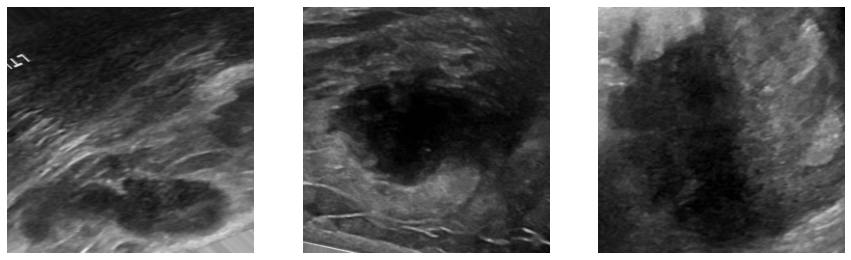

In [30]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(image_generator)[1]
    ax[i].imshow(image)
    ax[i].axis('off')

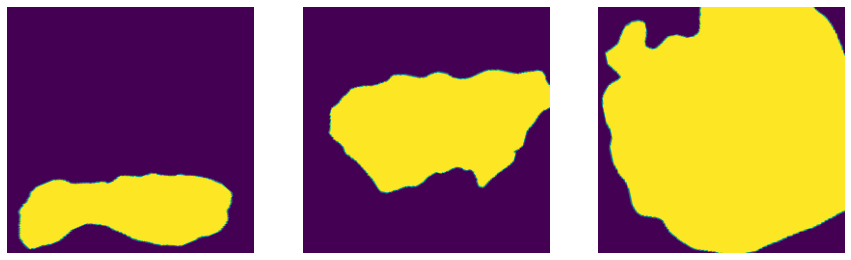

In [31]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
for i in range(3):
    image = next(mask_generator)[1]
    ax[i].imshow(image)
    ax[i].axis('off')

In [32]:
train_generator = zip(image_generator, mask_generator)

In [33]:
tf.keras.backend.clear_session()

**Step 9: Defining Loss Functions** In cross entropy loss, the loss is calculated as the average of per-pixel loss, and the per-pixel loss is calculated discretely, without knowing whether its adjacent pixels are boundaries or not.As a result, cross entropy loss only considers loss in a micro sense rather than considering it globally, which is not enough for image level prediction.<br>
![](https://miro.medium.com/max/1050/1*VMiADFOL7x0R9U32qK-C6Q.png)

**Dice loss** originates from *Sørensen–Dice coefficient*, which is a statistic developed in 1940s to gauge the similarity between two samples.Dice loss considers the loss information both locally and globally, which is critical for high accuracy.<br>
![](https://miro.medium.com/max/386/1*EF3VCtk-VbTIKhriaQF0YQ.png)<br>
Here,<br>
**pi,gi** : pairs of corresponding pixel values of prediction and ground truth<br>
*In boundary detection scenario, the values of pi and gi are either 0 or 1, representing whether the pixel is boundary (value of 1) or not (value of 0).*<br>
Therefore, the denominator is the sum of total boundary pixels of both prediction and ground truth, and the numerator is the sum of correctly predicted boundary pixels because the sum increments only when pi and gi match (both of value 1).

In [34]:
def dice_coeff(y_true, y_pred):
    smooth = 1.
    # Flatten
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    score = (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)
    return score

In [35]:
def dice_loss(y_true, y_pred):
    loss = 1 - dice_coeff(y_true, y_pred)
    return loss

In [36]:
def bce_dice_loss(y_true, y_pred):
    loss = losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)
    return loss

In [37]:
def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3])+K.sum(y_pred,[1,2,3])-intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

In [38]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

def loss(y_true, y_pred):
    return -(0.4*dice_coef(y_true, y_pred)+0.6*iou_coef(y_true, y_pred))

**Step 10: Building U-net Model**

**About U-net:** The UNET was developed by Olaf Ronneberger et al. for Bio Medical Image Segmentation. <br>
The architecture contains two paths. First path is the contraction path (also called as the encoder) which is used to capture the context in the image. The encoder is just a traditional stack of convolutional and max pooling layers. The second path is the symmetric expanding path (also called as the decoder) which is used to enable precise localization using transposed convolutions. Thus it is an end-to-end fully convolutional network (FCN), i.e. it only contains Convolutional layers and does not contain any Dense layer because of which it can accept image of any size.<br>
![](https://www.researchgate.net/publication/331406702/figure/fig2/AS:731276273262594@1551361258173/Illustration-of-the-U-net-architecture-The-figure-illustrates-the-U-net-architecture.png)

original code

In [39]:
# Resudual Unet Block

In [40]:
from keras.layers.merge import concatenate, add

In [41]:
def squeeze_excite_block(inputs, ratio=8):
    init = inputs
    channel_axis = -1
    filters = init.shape[channel_axis]
    se_shape = (1, 1, filters)

    se = GlobalAveragePooling2D()(init)
    se = Reshape(se_shape)(se)
    se = Dense(filters // ratio, activation='relu', kernel_initializer='he_normal', use_bias=False)(se)
    se = Dense(filters, activation='sigmoid', kernel_initializer='he_normal', use_bias=False)(se)

    x = Multiply()([init, se])
    return x

In [42]:
def resnet_block(x, n_filter, strides=1):
    x_init = x
    ## Conv 1
    #x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = Conv2D(n_filter, (3, 3), padding="same", strides=strides)(x)
    ## Conv 2
    #x = BatchNormalization()(x)
    x = Activation("relu")(x)
    x = Conv2D(n_filter, (3, 3), padding="same", strides=1)(x)
    ## Shortcut
    s  = Conv2D(n_filter, (1, 1), padding="same", strides=strides)(x_init)
    s = BatchNormalization()(s)
    ## Add
    x = Add()([x, s])
    x = squeeze_excite_block(x)
    return x

In [43]:
def get_runet():    
    inputs = Input((img_rows, img_cols, 3))
    
    conv1 = resnet_block(inputs,32 , strides=1)
    conv1 = tf.keras.layers.Dropout(0.1)(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = resnet_block(pool1,64 , strides=1)
    conv2 = tf.keras.layers.Dropout(0.1)(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = resnet_block(pool2, 128, strides=1)
    conv3 = tf.keras.layers.Dropout(0.2)(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = resnet_block(pool3, 256, strides=1)
    conv4 = tf.keras.layers.Dropout(0.2)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(pool4)
    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv5)
    conv5 = tf.keras.layers.Dropout(0.3)(conv5)
    
    up6 = concatenate([Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv5), conv4], axis=3)
    conv6 = resnet_block(up6, 256, strides=1)
    conv6 = tf.keras.layers.Dropout(0.2)(conv6)
    
    up7 = concatenate([Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv6), conv3], axis=3)
    conv7 = resnet_block(up7, 128, strides=1)
    conv7 = tf.keras.layers.Dropout(0.2)(conv7)

    up8 = concatenate([Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv7), conv2], axis=3)
    conv8 = resnet_block(up8, 64, strides=1)
    conv8 = tf.keras.layers.Dropout(0.1)(conv8)
    
    up9 = concatenate([Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(conv8), conv1], axis=3)
    conv9 = resnet_block(up9, 32, strides=1)
    conv9 = tf.keras.layers.Dropout(0.1)(conv9)
            
    conv9 = Conv2D(1, (1, 1), activation='sigmoid')(conv9)

    model = Model(inputs=[inputs], outputs=[conv9])
    model.compile(optimizer=Adam(), loss=[loss], metrics=[dice_coef, iou_coef])
    return model

In [44]:
img_rows = 256
img_cols = 256

**Step 11: Setting up Hyperparameters**

In [45]:
input_layer= Input((image_height, image_width, 3), name='img')
unet_model = get_runet()
unet_model.summary()

2022-11-11 12:47:32.896835: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-11 12:47:32.897830: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-11 12:47:33.201853: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-11 12:47:33.202903: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-11 12:47:33.203775: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
activation (Activation)         (None, 256, 256, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 32) 896         activation[0][0]                 
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 256, 256, 32) 0           conv2d[0][0]                     
______________________________________________________________________________________________

In [46]:

unet_model.compile(Adam(learning_rate=0.001),
                  loss= bce_dice_loss,
                  metrics=[dice_loss, dice_coeff, iou_coef,'accuracy'])

In [47]:
callbacks = [
    EarlyStopping(patience=10, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.0003, verbose=1),
    ModelCheckpoint('model-checkpoint.h5', verbose=1, save_best_only=True, save_weights_only=True) ]

In [48]:
batch_size = 4
#epochs = 2
epochs = 50

**Step 12: Training the model**

In [49]:
model_history = unet_model.fit(train_generator,  
                    batch_size=batch_size, 
                    steps_per_epoch=int(np.ceil(len(X_train) / float(batch_size))),
                    epochs=epochs, 
                    callbacks=callbacks,
                    validation_data=(X_valid, y_valid),
                    verbose = 1)

2022-11-11 12:47:39.526178: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/50


2022-11-11 12:47:46.088247: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


130/130 [==============================] - 90s 502ms/step - loss: 1.0565 - dice_loss: 0.6660 - dice_coeff: 0.3341 - iou_coef: 0.1762 - accuracy: 0.8411 - val_loss: 1.0954 - val_dice_loss: 0.8566 - val_dice_coeff: 0.1434 - val_iou_coef: 0.0653 - val_accuracy: 0.9193

Epoch 00001: val_loss improved from inf to 1.09541, saving model to model-checkpoint.h5
Epoch 2/50
130/130 [==============================] - 59s 457ms/step - loss: 0.9204 - dice_loss: 0.5758 - dice_coeff: 0.4242 - iou_coef: 0.2385 - accuracy: 0.8658 - val_loss: 1.0047 - val_dice_loss: 0.7670 - val_dice_coeff: 0.2330 - val_iou_coef: 0.1083 - val_accuracy: 0.9284

Epoch 00002: val_loss improved from 1.09541 to 1.00467, saving model to model-checkpoint.h5
Epoch 3/50
130/130 [==============================] - 59s 454ms/step - loss: 0.8706 - dice_loss: 0.5394 - dice_coeff: 0.4606 - iou_coef: 0.2645 - accuracy: 0.8731 - val_loss: 0.8319 - val_dice_loss: 0.5807 - val_dice_coeff: 0.4193 - val_iou_coef: 0.2413 - val_accuracy: 0.911

**Step 13: Learning Curve Visualization**


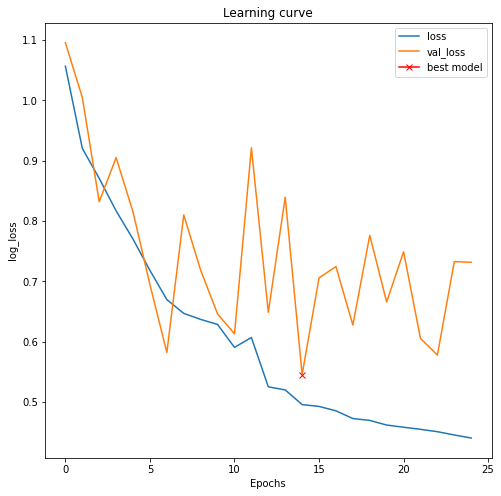

In [50]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(model_history.history["loss"], label="loss")
plt.plot(model_history.history["val_loss"], label="val_loss")
plt.plot( np.argmin(model_history.history["val_loss"]), np.min(model_history.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

**Step 14: Evaluating the model on test sets**

In [51]:
unet_model.load_weights('model-checkpoint.h5')
unet_model.evaluate(X_valid, y_valid, verbose=1)

5/5 [==============================] - 7s 189ms/step - loss: 0.5345 - dice_loss: 0.3580 - dice_coeff: 0.6420 - iou_coef: 0.5002 - accuracy: 0.9464


[0.5344570279121399,
 0.35797369480133057,
 0.6420263051986694,
 0.5002334117889404,
 0.9463769793510437]

In [52]:
ev = unet_model.evaluate(X_valid, y_valid, verbose=1)

5/5 [==============================] - 1s 186ms/step - loss: 0.5345 - dice_loss: 0.3580 - dice_coeff: 0.6420 - iou_coef: 0.5002 - accuracy: 0.9464


In [53]:
print(ev[1])

0.35797369480133057


In [54]:
preds_test = unet_model.predict(X_valid, verbose=1)
preds_test_t = (preds_test > 0.75).astype(np.uint8)

5/5 [==============================] - 2s 185ms/step


In [55]:
#Visualization of Predicted Mask

In [56]:
import io
from PIL import Image
import matplotlib.pyplot as plt

In [57]:

def plot_sample(X, y, preds, binary_preds, ix=None):
    #area = []
    #index = []
    if ix is None:
        ix = random.randint(0, len(X))
    print("test image:",ix)
    has_mask = y[ix].max() > 0
    fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    ax[0].imshow(X[ix])
    if has_mask:
        ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('Image')

    ax[1].imshow(y[ix].squeeze(), vmin=0, vmax=1)
    #print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    ax[1].set_title('Mask')
    
    #ratio = mask_ratio(y[ix])
    #print("area ratio of ground truth",ratio)

    ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    ax[2].set_title('Mask Predicted')
    
    ax[3].imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    ax[3].set_title('Mask Predicted binary');
    
    #ax[3].axis('off')
    # Save just the portion _inside_ the second axis's boundaries
    #extent = ax[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('pred_mask_bin.png', bbox_inches=extent)
    
    #ratio1 = mask_ratio(preds[ix])
    #print("area ratio of mask predicted by model",ratio1)
    
    #area_ratio_mask.append(ratio)
    #area_ratio_pred_mask.append(ratio1)
    #index.append(i)

test image: 25


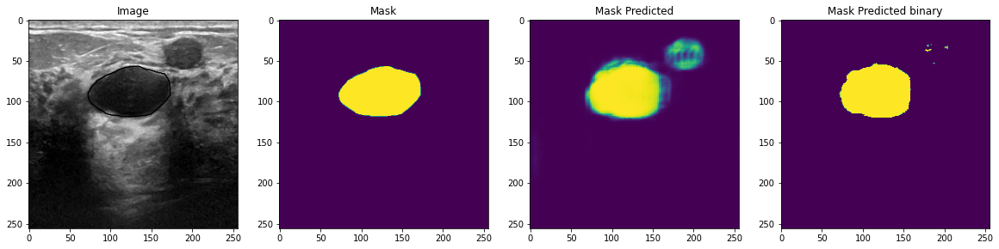

In [58]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 83


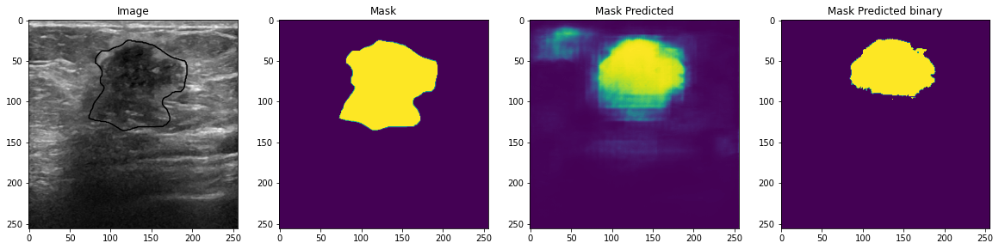

In [59]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=83)

test image: 84


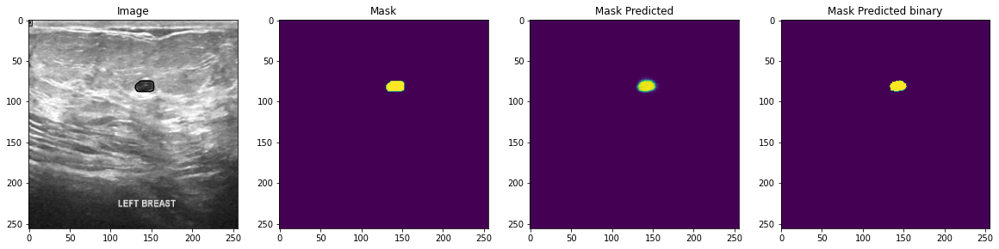

In [60]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=84)

test image: 85


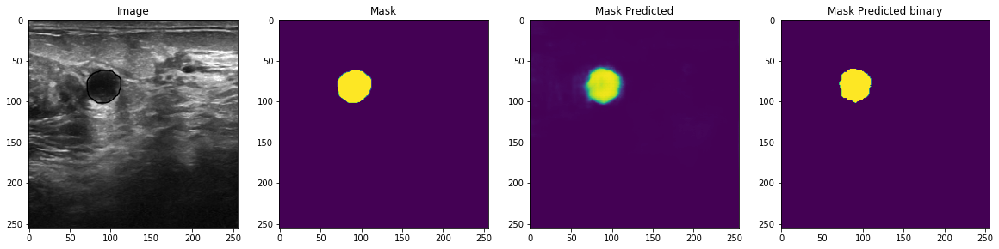

In [61]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=85)

test image: 72


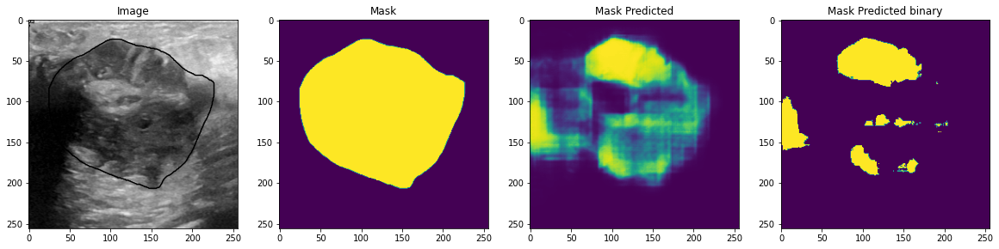

In [62]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 47


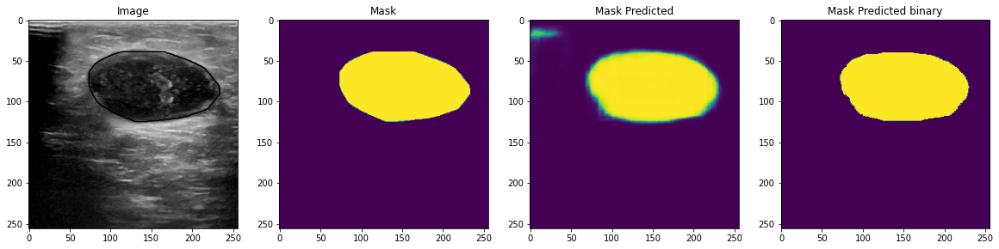

In [63]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t,ix=47)

test image: 34


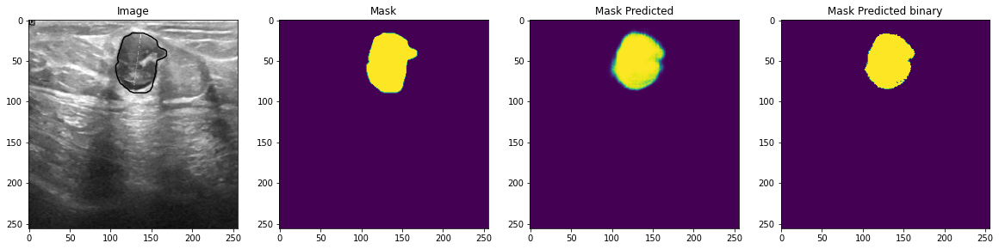

In [64]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 125


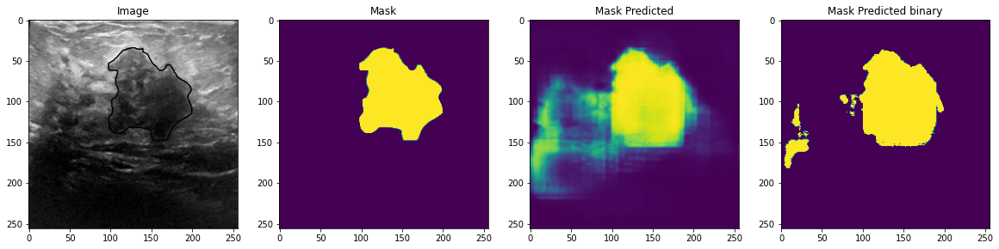

In [65]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 107


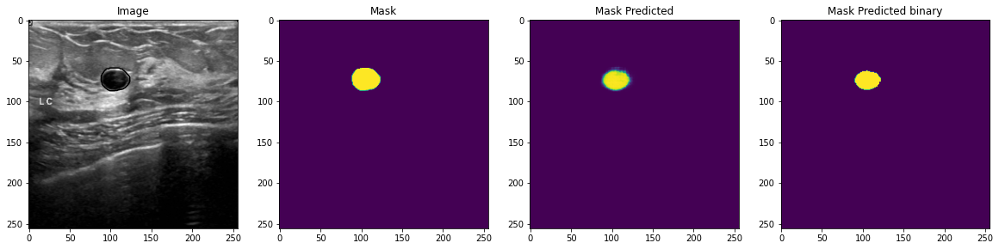

In [66]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 115


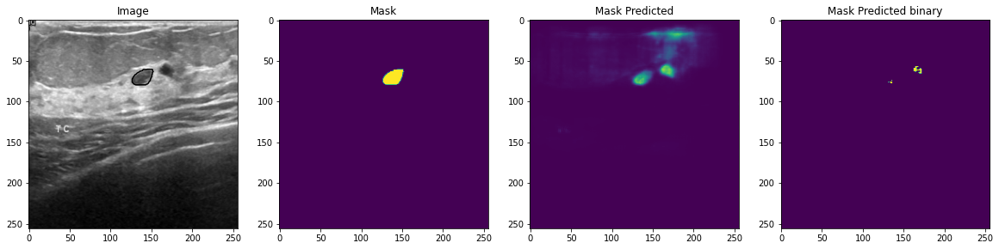

In [67]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 79


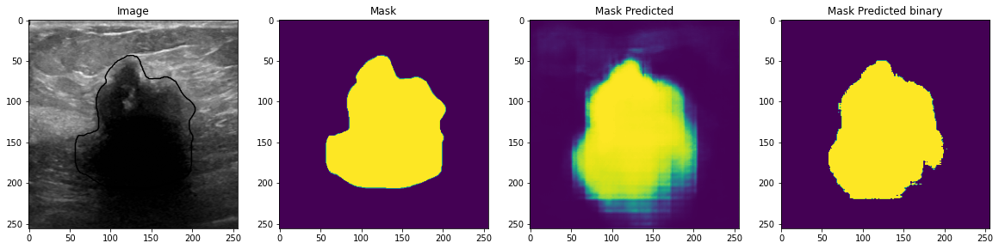

In [68]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 9


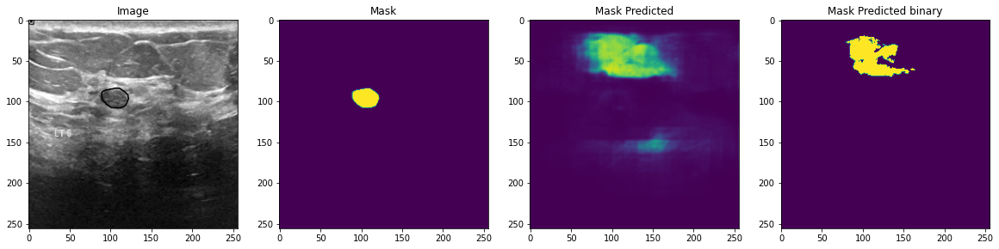

In [69]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

test image: 1


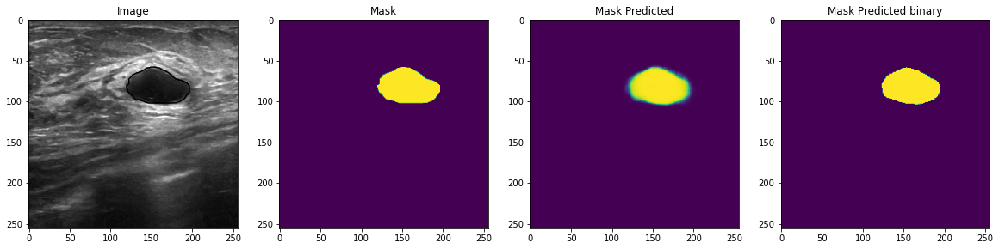

In [70]:
plot_sample(X_valid, y_valid, preds_test, preds_test_t)

In [71]:
# Function for  white_pixel_area_ratio

In [72]:
def mask_ratio(img):
    cv2.imwrite('a.png',img)
    img = cv2.imread('a.png')
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    thresh = cv2.threshold(gray,0,255,cv2.THRESH_OTSU + cv2.THRESH_BINARY)[1]
    pixels = cv2.countNonZero(thresh)
    image_area = img.shape[0] * img.shape[1]
    area_ratio = (pixels / image_area) * 100
    return area_ratio

In [73]:
# function for rectangle box approach for calculating Area of the tumour uisng opencv library

In [74]:
def midpoint(ptA, ptB):
	return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

In [75]:
# defining an object function for measuring the size of tumour is inches assuming pixel_per_metrix as 157
# 157 pixels per every 0.955 inches in our images
# https://pyimagesearch.com/2016/03/28/measuring-size-of-objects-in-an-image-with-opencv/
def object_opencv(img):
    #print(img)
    #image = cv2.imread(img)
    cv2.imwrite('a.png',img)
    image = cv2.imread('a.png')
    #image = image[0:250, 120:432]
    #image = cv2.resize(image, (image_height, image_width))
    #image = image/255.0
    #image.dtype = np.uint8
    #image = cv2.imread('b.png')
    #print(image)
    #print(image.shape)
    #print('X')
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #print(gray.shape)
    #gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    thresh = cv2.threshold(gray,0,255,cv2.THRESH_OTSU + cv2.THRESH_BINARY)[1]
    #thresh = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY)[1]
    #(thresh, blackAndWhiteImage) = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
    gray = cv2.GaussianBlur(thresh, (7, 7), 0)
    #print(gray)
    #plt.imshow(thresh)
    #plt.show()
    edged = cv2.Canny(gray, 50, 100)
    edged = cv2.dilate(edged, None, iterations=1)
    edged = cv2.erode(edged, None, iterations=1)
    #print(edged.shape)
    cnts = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    #print("1:",cnts)
    cnts = imutils.grab_contours(cnts)
    #print("2:",cnts)
    cv2.drawContours(image, cnts, -1, (0, 255, 0), 3)
    (cnts, _) = contours.sort_contours(cnts)
    #print("3:",cnts)
    for c in cnts:
        # if the contour is not sufficiently large, ignore it
        if cv2.contourArea(c) < 0:
            continue

        # compute the rotated bounding box of the contour
        orig = image.copy()
        box = cv2.minAreaRect(c)
        box = cv2.cv.BoxPoints(box) if imutils.is_cv2() else cv2.boxPoints(box)
        box = np.array(box, dtype="int")
        #print(box)
        # order the points in the contour such that they appear
        # in top-left, top-right, bottom-right, and bottom-left
        # order, then draw the outline of the rotated bounding
        # box
        box = perspective.order_points(box)
        print(box)
        cv2.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
    
        #My chnages
        #cv2.imshow("Image", orig)
        #cv2.waitKey(0)
        #cv2.destroyAllWindows()
    
        # loop over the original points and draw them
        for (x, y) in box:
            cv2.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)
        
        #My chnages
        #cv2.imshow("Image", orig)
        #cv2.waitKey(0)
        #cv2.destroyAllWindows()

        # unpack the ordered bounding box, then compute the midpoint
        # between the top-left and top-right coordinates, followed by
        # the midpoint between bottom-left and bottom-right coordinates
        (tl, tr, br, bl) = box
        (tltrX, tltrY) = midpoint(tl, tr)
        (blbrX, blbrY) = midpoint(bl, br)

        # compute the midpoint between the top-left and top-right points,
        # followed by the midpoint between the top-righ and bottom-right
        (tlblX, tlblY) = midpoint(tl, bl)
        (trbrX, trbrY) = midpoint(tr, br)

        # draw the midpoints on the image
        cv2.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
        cv2.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
        cv2.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
        cv2.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)

        # draw lines between the midpoints
        cv2.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
        cv2.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)

        # compute the Euclidean distance between the midpoints
        dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
        dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
        #print("dA",dA)
        #print("dB",dB)
        #print("pixelsPerMetric",pixelsPerMetric)

        # if the pixels per metric has not been initialized, then
        # compute it as the ratio of pixels to supplied metric
        # (in this case, inches)
        #my chnages 
        #if pixelsPerMetric is None:
        #    pixelsPerMetric = dB /4.2
        pixelsPerMetric= 157
        # compute the size of the object
        dimA = dA / pixelsPerMetric
        dimB = dB / pixelsPerMetric
        print("dimA",dimA)
        print("dimB",dimB)
      
        #length = []
        #width = []
        #length.append(dimA)
        #width.append(dimB)
        # draw the object sizes on the image
        cv2.putText(orig, "{:.1f}in".format(dimB),(int(tltrX - 15), int(tltrY - 10)), cv2.FONT_HERSHEY_SIMPLEX,0.65, (200, 100, 100), 2)
        cv2.putText(orig, "{:.1f}in".format(dimA),(int(trbrX - 50), int(trbrY)), cv2.FONT_HERSHEY_SIMPLEX,0.65, (200, 100, 100), 2)

        # show the output image
        #orig = cv2.resize(orig, (0,0),fx=.55,fy=1)
        #orig= cv2.resize(orig, (900, 200))
        #plt.imshow(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
        plt.imshow(orig)
        plt.show()
        #cv2.imshow("Image", orig)
        #cv2.waitKey(0)
        #cv2.destroyAllWindows()
        #return length,width
        return dimA,dimB,tl,tr,bl,br
    

In [76]:
index = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
    #pred_img = []
    #pred_mask_img = []
area_ratio_mask = []
area_ratio_pred_mask = []

In [79]:

    
def plot_sample4(X, y, preds, binary_preds, ix=None):
  
    if ix is None:
        ix = random.randint(0, len(X))
    print("test image:",ix)
    has_mask = y[ix].max() > 0
    fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    ax[0].imshow(X[ix])
    if has_mask:
        ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    ax[0].set_title('Image')

    ax[1].imshow(y[ix].squeeze())
    print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    ax[1].set_title('Mask')
    
    ratio = mask_ratio(y[ix])
    print("area ratio of ground truth",ratio)

    ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    ax[2].set_title('Mask Predicted')
    
    
    
    ax[3].imshow(binary_preds[ix])
    #ax[3].set_title('Mask Predicted binary');
    
    ax[3].axis('off')
    # Save just the portion _inside_ the second axis's boundaries
    extent = ax[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    fig.savefig('pred_mask_bin.png', bbox_inches=extent)
    image1 = cv2.imread('pred_mask_bin.png')
    image1 = image1[150:390,:]
    ratio1 = mask_ratio(image1)
    area_ratio_mask.append(ratio)
    area_ratio_pred_mask.append(ratio1)
    index.append(ix)
    print("area ratio of mask predicted by model",ratio1)
    #if ((ratio1 != 100)) :
    if ((ratio1 != 100) & (ratio1 >= 1)) :
        len1,wid,tl,tr,bl,br = object_opencv(image1)
        length.append(len1)
        width.append(wid)
        top_left.append(tl)
        top_right.append(tr)
        bottom_left.append(bl)
        bottom_right.append(br)
        



def plot_sample1(X, y, preds, binary_preds, ix=None):
    if ix is None:
        ix = random.randint(0, len(X))
    #print("test image:",ix)
    has_mask = y[ix].max() > 0
    #fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    #ax[0].imshow(X[ix])
    #if has_mask:
    #    ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    #ax[0].set_title('Image')

    #ax[1].imshow(y[ix].squeeze())
    #print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    #ax[1].set_title('Mask')
    
    ratio = mask_ratio(y[ix])
    #print("area ratio of ground truth",ratio)

    #ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[2].set_title('Mask Predicted')
    
    #ax[3].imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[3].set_title('Mask Predicted binary');
    
    ratio1 = mask_ratio(preds[ix])
    #print("area ratio of mask predicted by model",ratio1)
    #print(preds[ix])
    pred_mask_img.append(binary_preds[ix])
    pred_img.append(preds[ix])
    area_ratio_mask.append(ratio)
    area_ratio_pred_mask.append(ratio1)
    index.append(i)

pred_img = []
pred_mask_img = []
area_ratio_mask = []
area_ratio_pred_mask = []

index = []
for i in range (0,len(X_valid)):
    plot_sample1(X_valid, y_valid, preds_test, preds_test_t,ix=i)
    

test image: 0
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.21209716796875
area ratio of mask predicted by model 4.375
[[ 81.  44.]
 [162.  46.]
 [161.  87.]
 [ 80.  84.]]
dimA 0.25804040635611014
dimB 0.5161692424421274


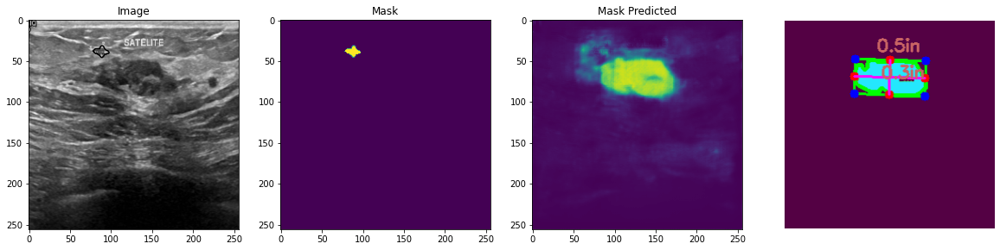

test image: 1
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.8055419921875
area ratio of mask predicted by model 3.6725206611570247
[[124.  47.]
 [188.  67.]
 [176. 107.]
 [112.  88.]]
dimA 0.26904702879609027
dimB 0.4261451152077001


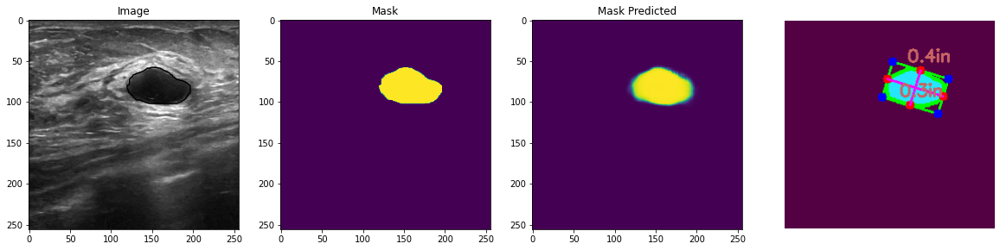

test image: 2
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.421630859375
area ratio of mask predicted by model 10.43732782369146
[[ 93.  31.]
 [201.  73.]
 [172. 145.]
 [ 65. 102.]]
dimA 0.4902597049310066
dimB 0.7362820395985281


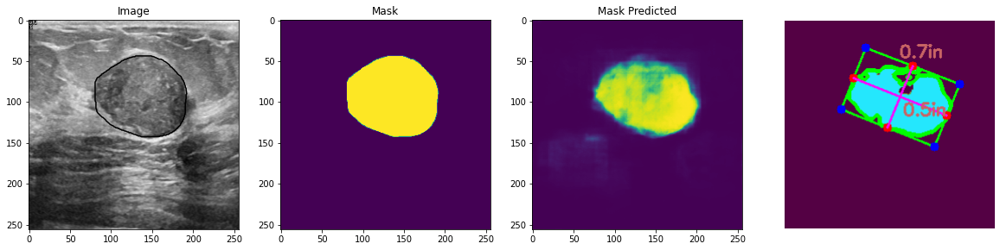

test image: 3
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.5462646484375
area ratio of mask predicted by model 6.101928374655648
[[  0. 140.]
 [ 79. 140.]
 [ 79. 225.]
 [  0. 225.]]
dimA 0.5414012738853503
dimB 0.5031847133757962


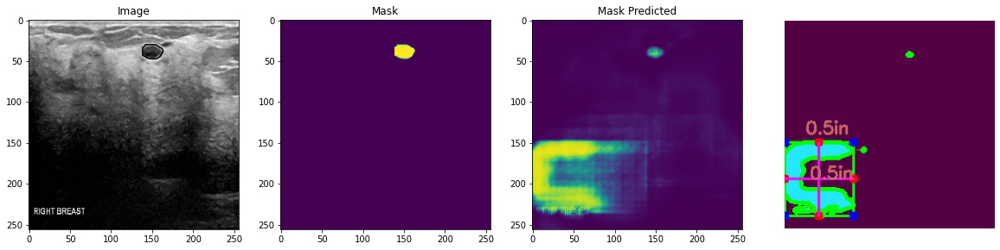

test image: 4
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.4190673828125
area ratio of mask predicted by model 0.21177685950413222
test image: 5
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 36.14654541015625
area ratio of mask predicted by model 19.092630853994493
[[ 2.  0.]
 [21.  0.]
 [21. 18.]
 [ 2. 18.]]
dimA 0.11464968152866242
dimB 0.12101910828025478


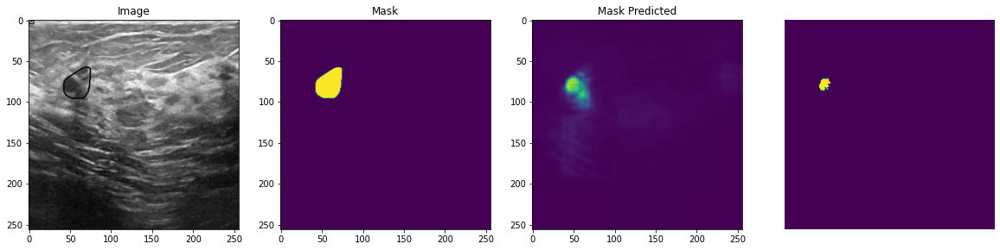

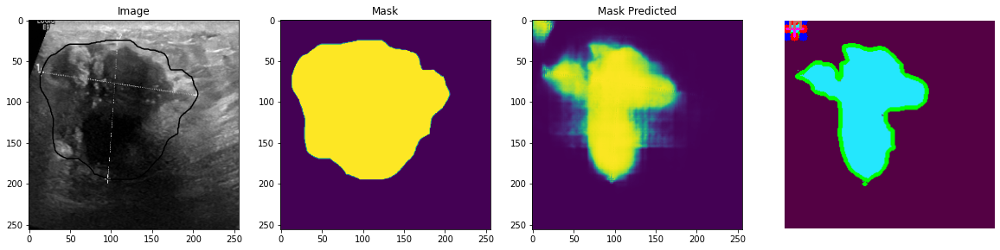

test image: 6
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.850341796875
area ratio of mask predicted by model 2.803030303030303
[[127.  69.]
 [161.  36.]
 [193.  68.]
 [159. 101.]]
dimA 0.2882473502926054
dimB 0.301792553897634


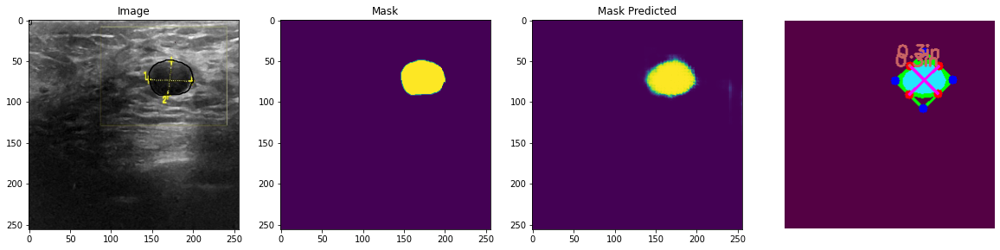

test image: 7
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.9124755859375
area ratio of mask predicted by model 0.6163911845730028
test image: 8
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.88189697265625
area ratio of mask predicted by model 4.6005509641873275
[[104.  29.]
 [157.  70.]
 [124. 113.]
 [ 70.  73.]]
dimA 0.34970995208928163
dimB 0.4273928066081733


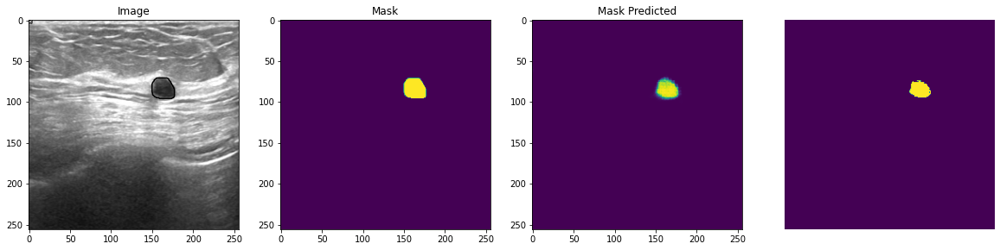

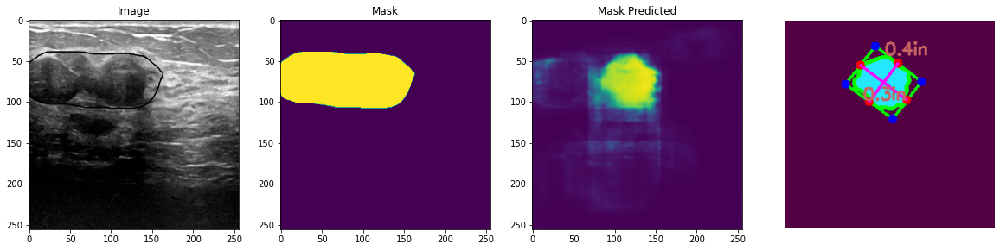

test image: 9
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.94451904296875
area ratio of mask predicted by model 3.1904269972451793
[[ 75.  16.]
 [156.  21.]
 [154.  66.]
 [ 73.  62.]]
dimA 0.290088756893016
dimB 0.5167191318340112


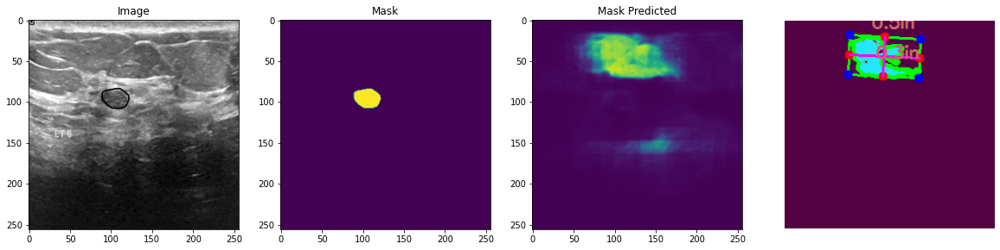

test image: 10
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.127685546875
area ratio of mask predicted by model 100.0
test image: 11
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.13983154296875
area ratio of mask predicted by model 3.3436639118457303
[[147.  29.]
 [196. -12.]
 [227.  24.]
 [178.  65.]]
dimA 0.3025980514705657
dimB 0.4069460597442876


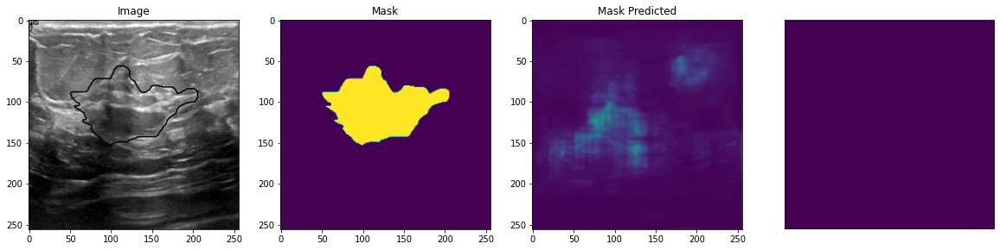

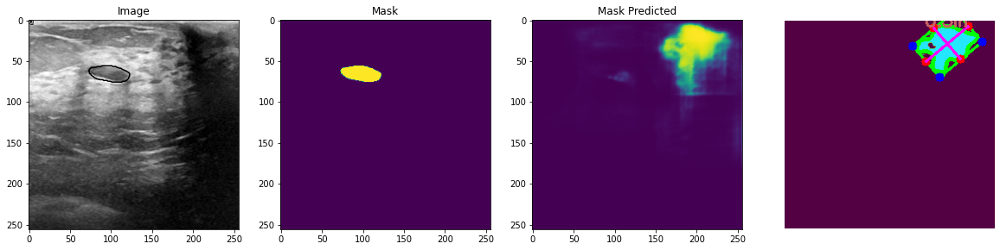

test image: 12
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.04913330078125
area ratio of mask predicted by model 0.03271349862258953
test image: 13
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.80596923828125
area ratio of mask predicted by model 5.3099173553719
[[161.  28.]
 [241.  28.]
 [241.  78.]
 [161.  78.]]
dimA 0.3184713375796178
dimB 0.5095541401273885


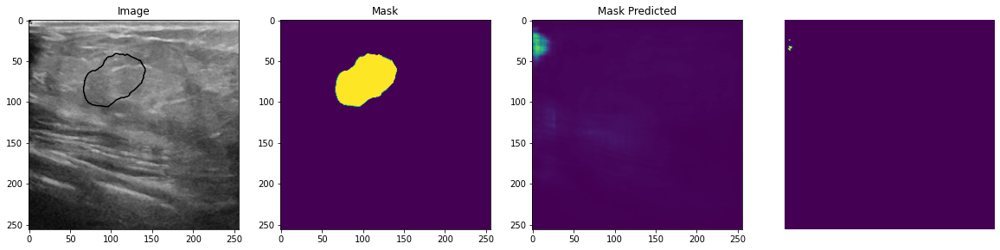

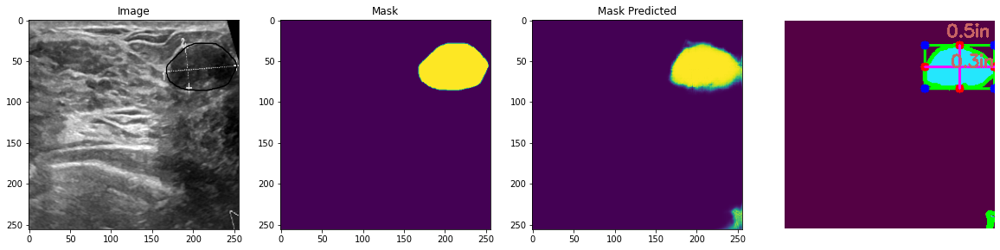

test image: 14
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 13.8641357421875
area ratio of mask predicted by model 9.244146005509641
[[ 73.  54.]
 [154.  70.]
 [137. 155.]
 [ 56. 139.]]
dimA 0.5521231320450787
dimB 0.5258925210819876


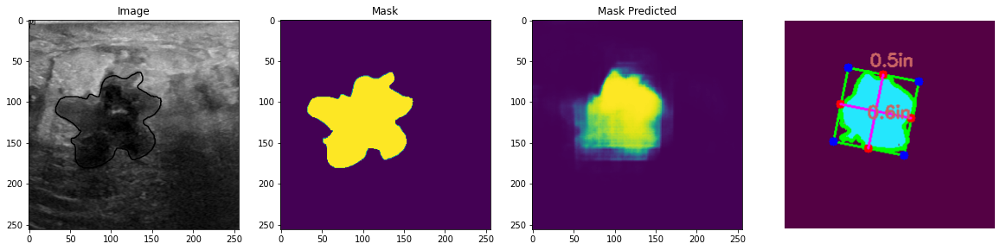

test image: 15
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.17132568359375
area ratio of mask predicted by model 1.5650826446280992
[[114.  41.]
 [162.  41.]
 [162.  69.]
 [114.  69.]]
dimA 0.17834394904458598
dimB 0.3057324840764331


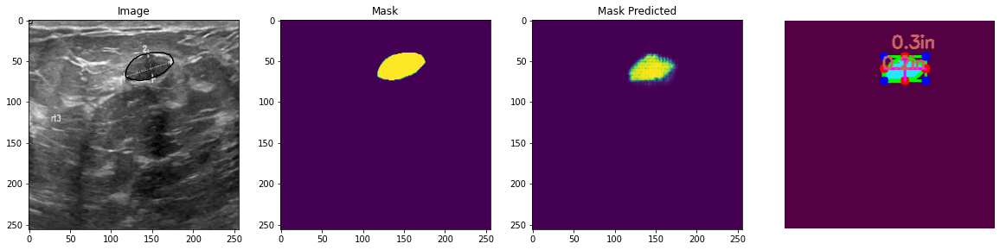

test image: 16
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.001953125
area ratio of mask predicted by model 1.268939393939394
[[140.  65.]
 [176.  65.]
 [176.  92.]
 [140.  92.]]
dimA 0.17197452229299362
dimB 0.22929936305732485


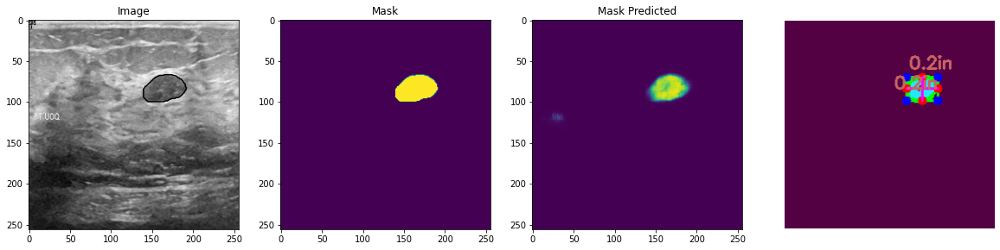

test image: 17
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.73992919921875
area ratio of mask predicted by model 4.1115702479338845
[[ 27.  27.]
 [ 88.  12.]
 [101.  62.]
 [ 39.  78.]]
dimA 0.3313632669291609
dimB 0.4039693113484479


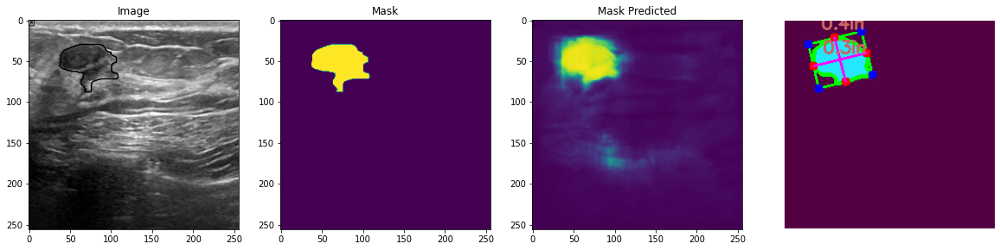

test image: 18
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.46221923828125
area ratio of mask predicted by model 4.3061294765840215
[[ 46.  65.]
 [116.  60.]
 [120. 106.]
 [ 50. 112.]]
dimA 0.29727213959384247
dimB 0.44723400621902043


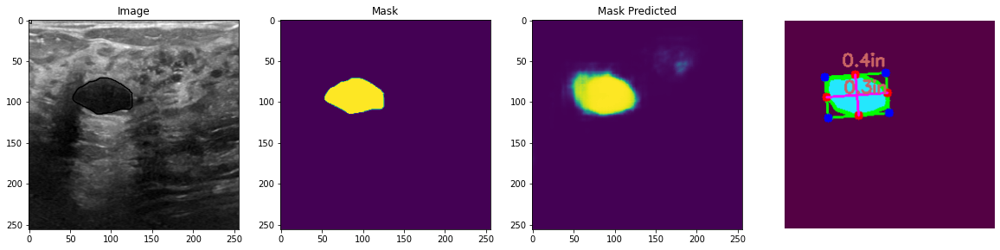

test image: 19
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.06146240234375
area ratio of mask predicted by model 2.0678374655647382
[[122.  32.]
 [175.  32.]
 [175.  65.]
 [122.  65.]]
dimA 0.21019108280254778
dimB 0.3375796178343949


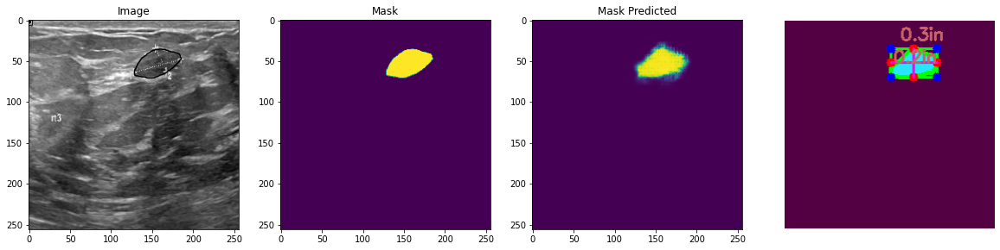

test image: 20
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.00323486328125
area ratio of mask predicted by model 9.691804407713498
[[  2.  47.]
 [ 94.  47.]
 [ 94. 121.]
 [  2. 121.]]
dimA 0.4713375796178344
dimB 0.5859872611464968


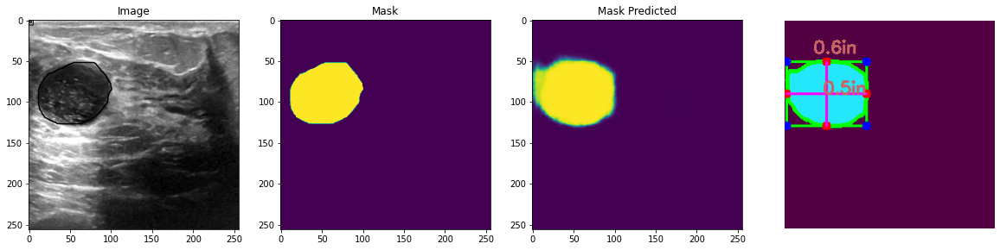

test image: 21
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.42974853515625
area ratio of mask predicted by model 1.1828512396694215
[[61. 68.]
 [98. 68.]
 [98. 92.]
 [61. 92.]]
dimA 0.15286624203821655
dimB 0.2356687898089172


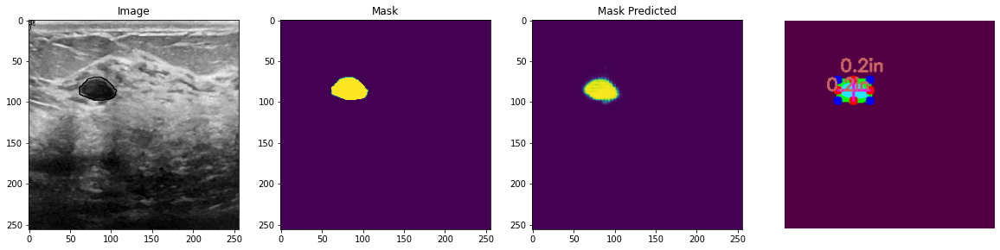

test image: 22
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.95062255859375
area ratio of mask predicted by model 0.471763085399449
test image: 23
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 23.541259765625
area ratio of mask predicted by model 19.678030303030305
[[135.  -5.]
 [227.  96.]
 [141. 174.]
 [ 49.  71.]]
dimA 0.7352481771092481
dimB 0.874909800442944


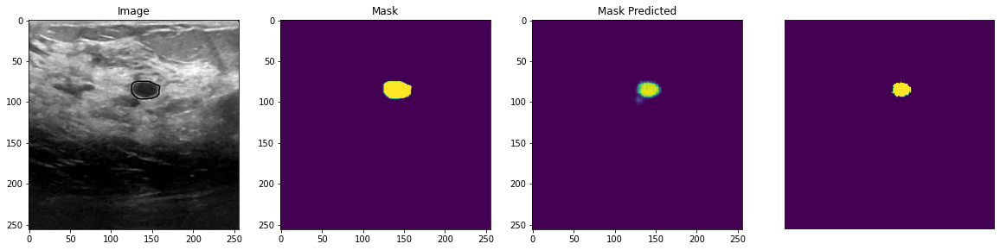

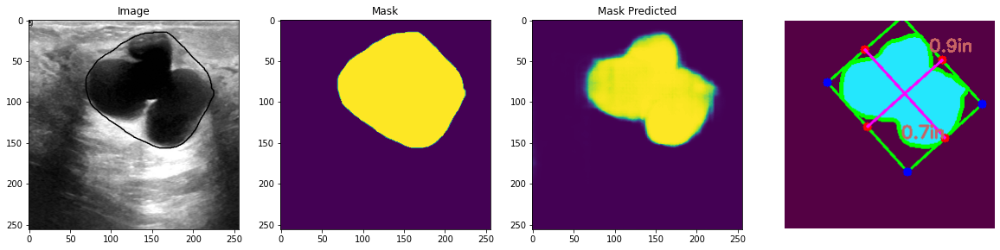

test image: 24
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.258544921875
area ratio of mask predicted by model 16.174242424242426
[[ 85.  78.]
 [237.  95.]
 [226. 193.]
 [ 74. 176.]]
dimA 0.6281236599782172
dimB 0.9741891941441669


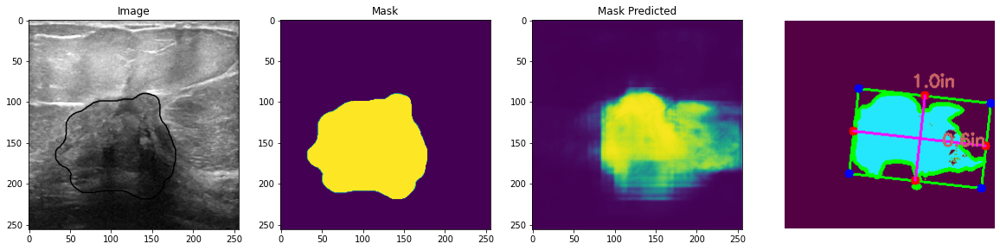

test image: 25
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.2021484375
area ratio of mask predicted by model 7.21935261707989
[[ 68.  50.]
 [150.  50.]
 [150. 113.]
 [ 68. 113.]]
dimA 0.4012738853503185
dimB 0.5222929936305732


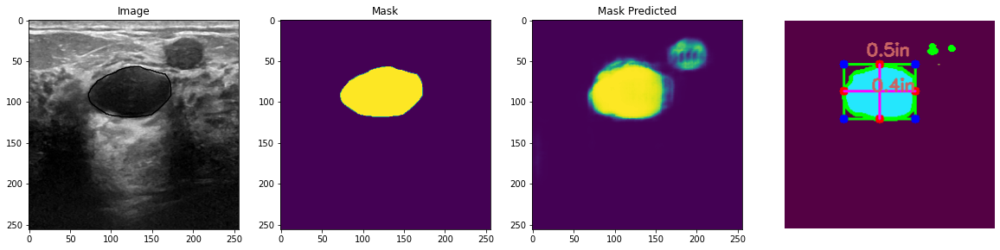

test image: 26
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 11.06719970703125
area ratio of mask predicted by model 12.725550964187327
[[  2.  62.]
 [117.  62.]
 [117. 143.]
 [  2. 143.]]
dimA 0.5159235668789809
dimB 0.732484076433121


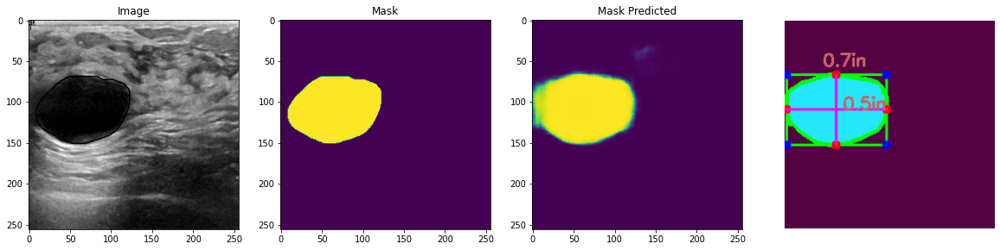

test image: 27
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.1749267578125
area ratio of mask predicted by model 1.8543388429752066
[[168.  70.]
 [214.  64.]
 [218.  95.]
 [172. 101.]]
dimA 0.19908916698200999
dimB 0.2954755033055593


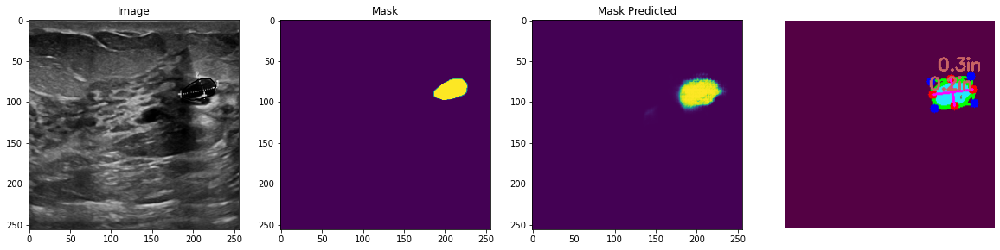

test image: 28
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 9.893798828125
area ratio of mask predicted by model 100.0
test image: 29
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 10.24627685546875
area ratio of mask predicted by model 5.2393250688705235
[[69. 65.]
 [73. 65.]
 [73. 73.]
 [69. 73.]]
dimA 0.050955414012738856
dimB 0.025477707006369428


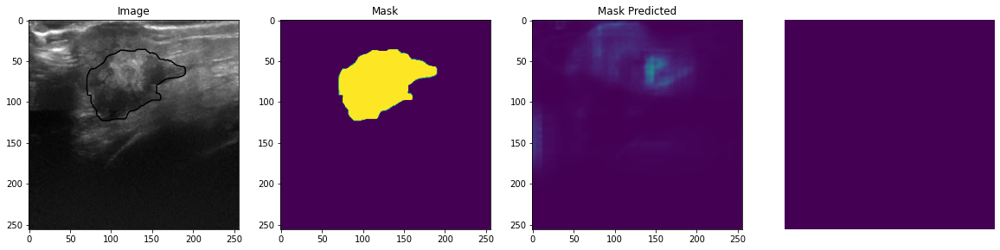

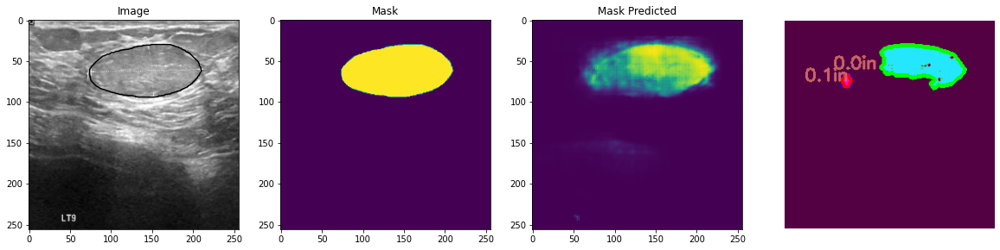

test image: 30
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 16.13311767578125
area ratio of mask predicted by model 29.085743801652892
[[ 99.  39.]
 [222.  89.]
 [154. 255.]
 [ 31. 204.]]
dimA 1.1396513613224495
dimB 0.8469002599517257


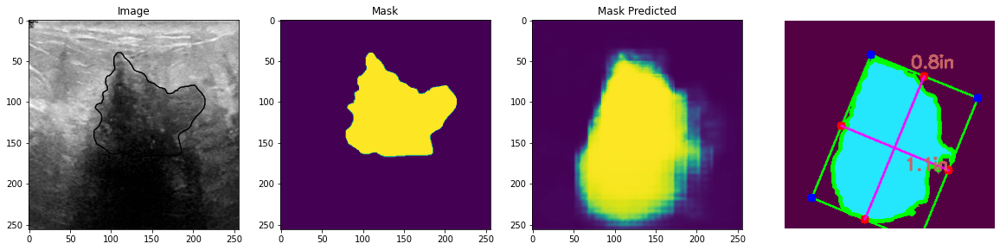

test image: 31
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 23.51531982421875
area ratio of mask predicted by model 24.727961432506888
[[ 61.  40.]
 [207.   3.]
 [238. 127.]
 [ 92. 163.]]
dimA 0.8110271394308223
dimB 0.9585564034079275


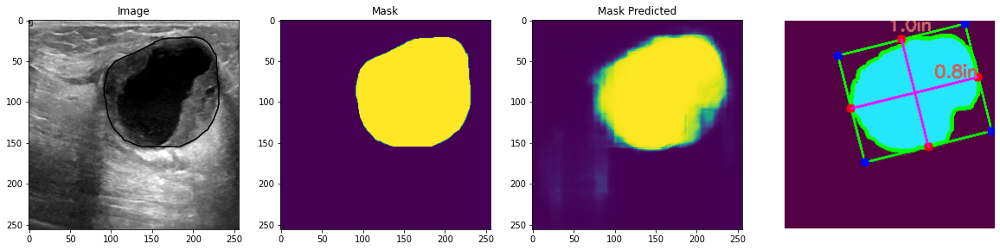

test image: 32
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.4271240234375
area ratio of mask predicted by model 0.20833333333333334
test image: 33
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.02764892578125
area ratio of mask predicted by model 6.658057851239669
[[ 0. 21.]
 [ 9. 22.]
 [ 6. 86.]
 [-2. 85.]]
dimA 0.4079542007181262
dimB 0.05451351200198627


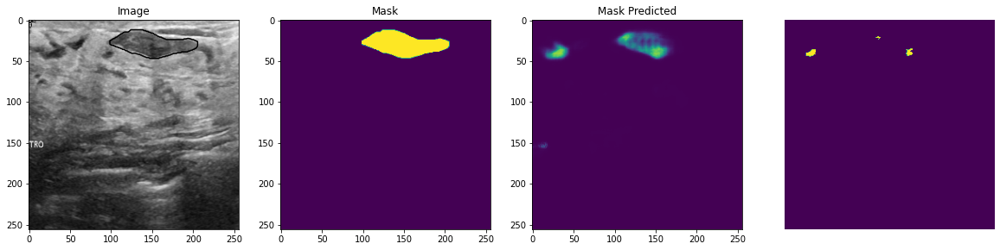

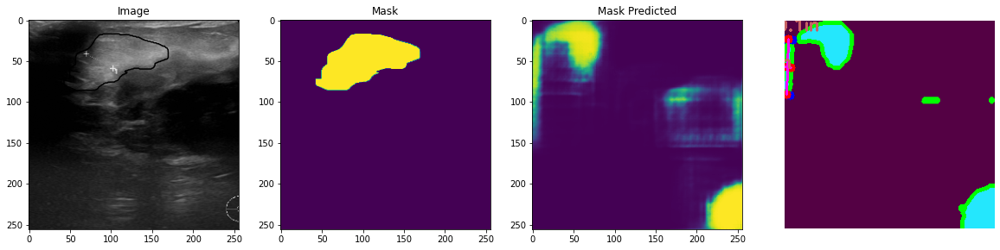

test image: 34
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.90570068359375
area ratio of mask predicted by model 4.648760330578512
[[108.  10.]
 [159.  23.]
 [142.  86.]
 [ 91.  73.]]
dimA 0.41562644843504337
dimB 0.3352279583933953


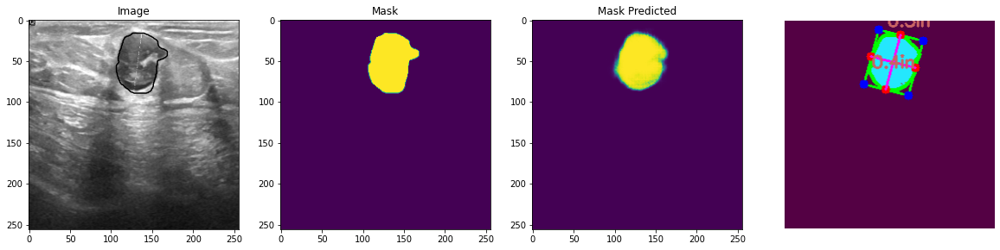

test image: 35
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 42.99468994140625
area ratio of mask predicted by model 48.484848484848484
[[  2.  19.]
 [223.  19.]
 [223. 193.]
 [  2. 193.]]
dimA 1.10828025477707
dimB 1.4076433121019107


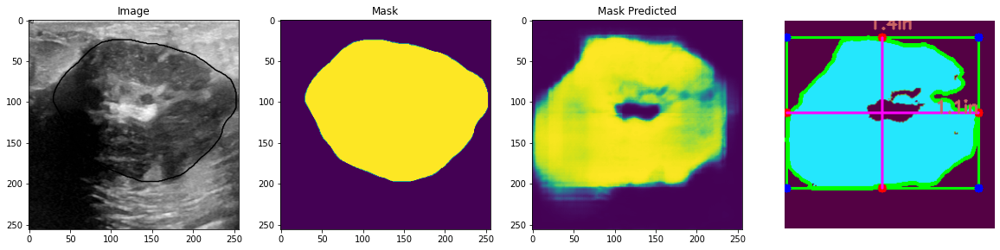

test image: 36
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.56707763671875
area ratio of mask predicted by model 0.3891184573002755
test image: 37
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.41229248046875
area ratio of mask predicted by model 5.4097796143250685
[[ 50. 100.]
 [150.  84.]
 [156. 127.]
 [ 57. 143.]]
dimA 0.2769968422173826
dimB 0.6418995022530692


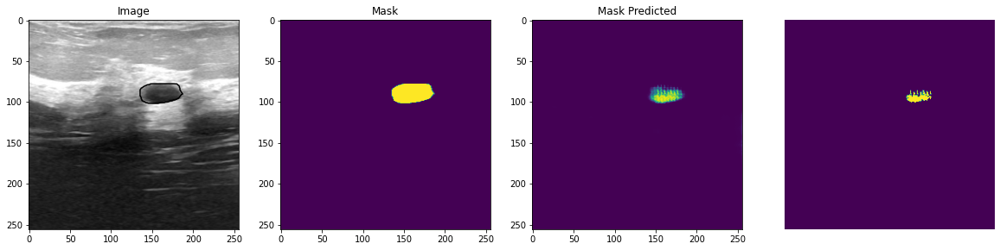

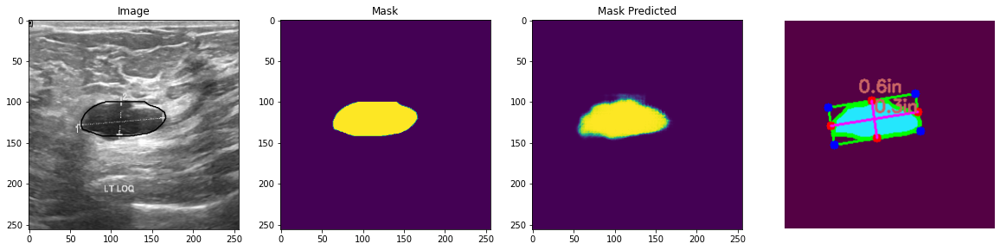

test image: 38
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.2235107421875
area ratio of mask predicted by model 2.5068870523415976
[[134.  16.]
 [197.  16.]
 [197.  44.]
 [134.  44.]]
dimA 0.17834394904458598
dimB 0.4012738853503185


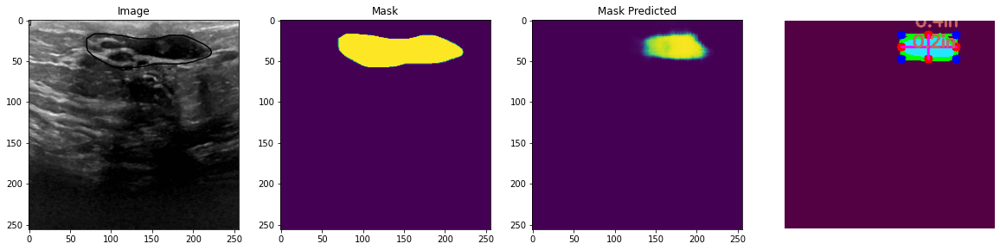

test image: 39
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.50506591796875
area ratio of mask predicted by model 0.11363636363636363
test image: 40
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.47607421875
area ratio of mask predicted by model 0.5785123966942148
test image: 41
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.83465576171875
area ratio of mask predicted by model 0.7386363636363636
test image: 42
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.99261474609375
area ratio of mask predicted by model 16.79235537190083
[[121.  22.]
 [234.  11.]
 [244. 122.]
 [131. 133.]]
dimA 0.7098696824941789
dimB 0.7231473620119732


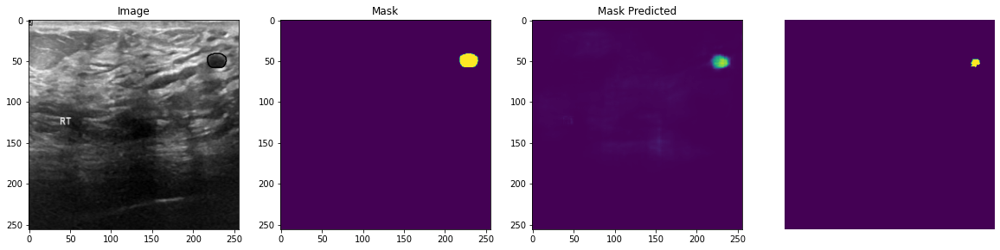

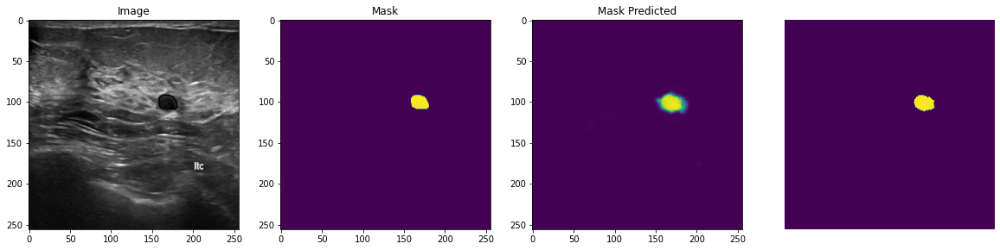

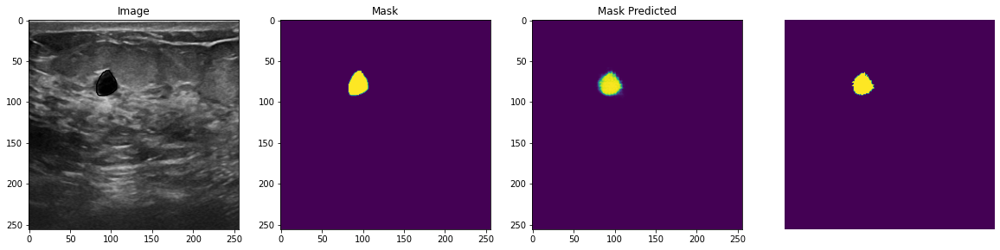

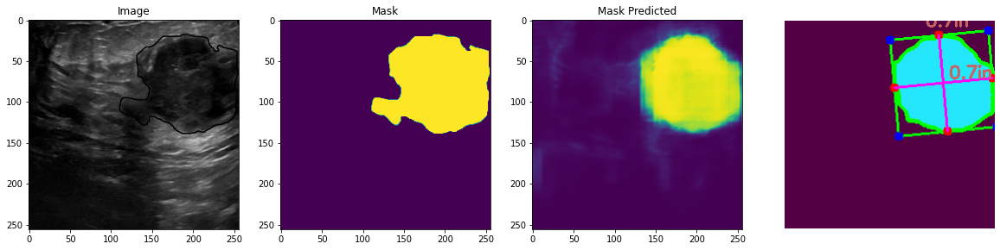

test image: 43
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.88043212890625
area ratio of mask predicted by model 2.234848484848485
[[  2. 216.]
 [ 41. 228.]
 [ 38. 239.]
 [  0. 227.]]
dimA 0.07185040874317501
dimB 0.25685853568699635


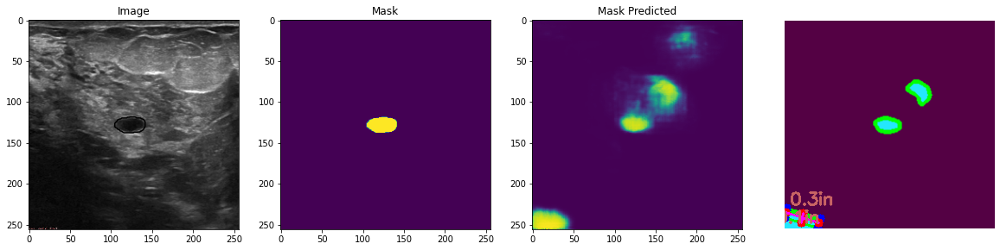

test image: 44
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.90625
area ratio of mask predicted by model 1.8543388429752066
[[201.   0.]
 [241.  24.]
 [232.  39.]
 [192.  15.]]
dimA 0.11141946295882739
dimB 0.2971185678902064


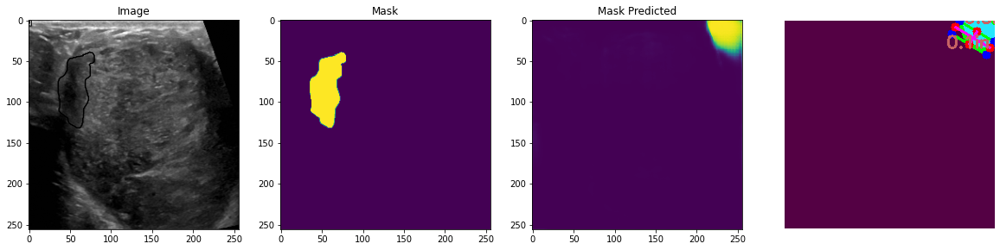

test image: 45
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 11.65313720703125
area ratio of mask predicted by model 12.894283746556473
[[ 62.  13.]
 [178.  13.]
 [178.  93.]
 [ 62.  93.]]
dimA 0.5095541401273885
dimB 0.7388535031847133


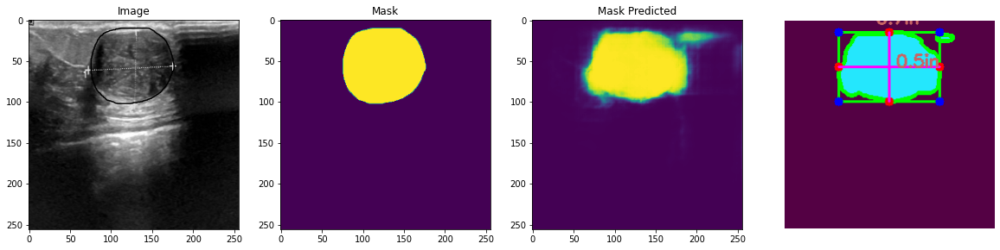

test image: 46
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 11.85455322265625
area ratio of mask predicted by model 8.305785123966942
[[ 18. 150.]
 [ 22. 150.]
 [ 22. 157.]
 [ 18. 157.]]
dimA 0.044585987261146494
dimB 0.025477707006369428


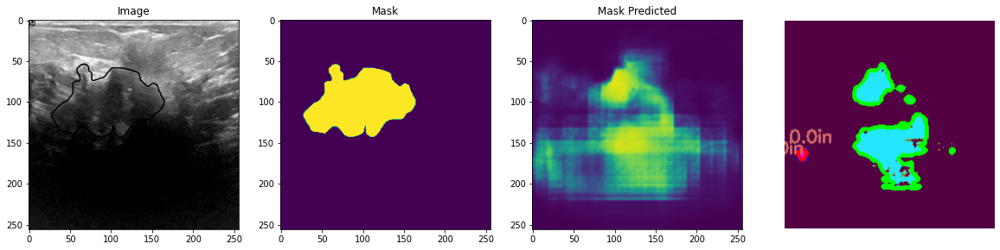

test image: 47
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 16.38946533203125
area ratio of mask predicted by model 16.74414600550964
[[ 68.  37.]
 [217.  37.]
 [217. 117.]
 [ 68. 117.]]
dimA 0.5095541401273885
dimB 0.9490445859872612


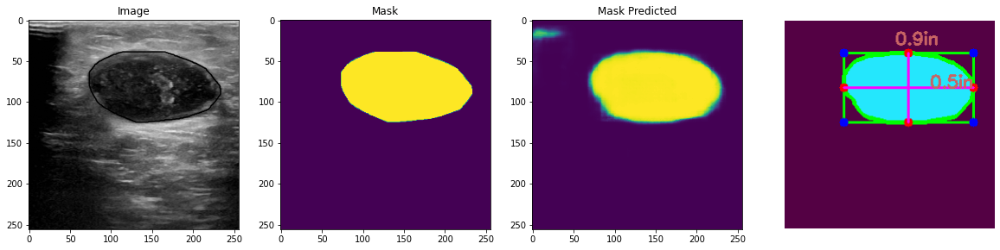

test image: 48
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.53656005859375
area ratio of mask predicted by model 1.3808539944903582
[[105.  57.]
 [142.  66.]
 [136.  92.]
 [ 99.  82.]]
dimA 0.1668558840436909
dimB 0.24331293560400075


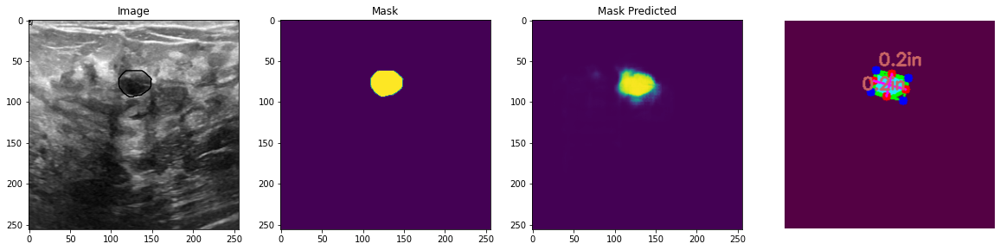

test image: 49
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.02691650390625
area ratio of mask predicted by model 7.202134986225896
[[ 96.  58.]
 [143.  65.]
 [129. 163.]
 [ 83. 156.]]
dimA 0.6300985796282157
dimB 0.2995154782051333


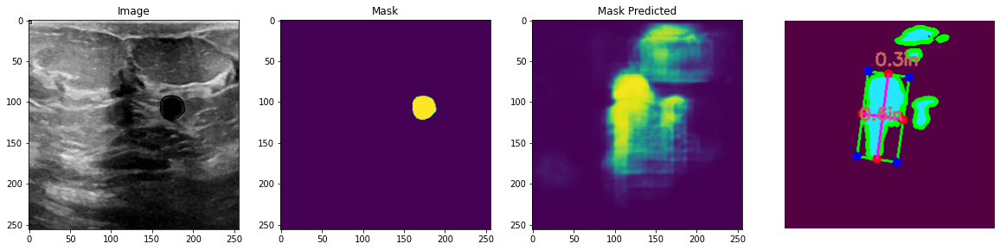

test image: 50
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.87811279296875
area ratio of mask predicted by model 12.264118457300276
[[  3.  85.]
 [ 88.  85.]
 [ 88. 162.]
 [  3. 162.]]
dimA 0.49044585987261147
dimB 0.5414012738853503


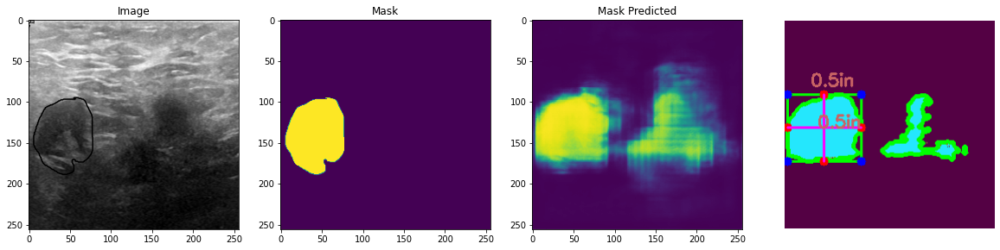

test image: 51
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 10.92987060546875
area ratio of mask predicted by model 0.0017217630853994489
test image: 52
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 17.5628662109375
area ratio of mask predicted by model 13.601928374655648
[[  3.  24.]
 [ 99.  25.]
 [ 98. 126.]
 [  2. 124.]]
dimA 0.640159076441023
dimB 0.6115396053173985


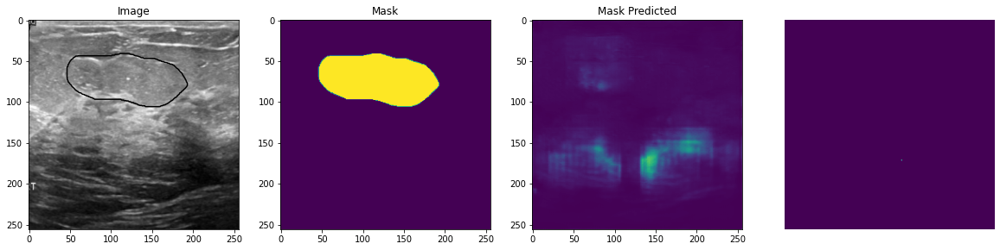

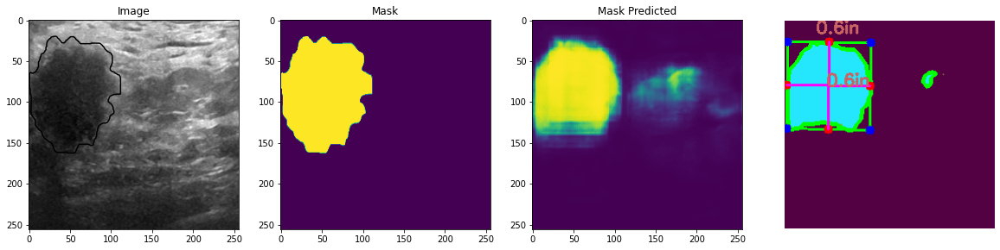

test image: 53
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.30902099609375
area ratio of mask predicted by model 0.024104683195592287
test image: 54
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 9.5733642578125
area ratio of mask predicted by model 11.18629476584022
[[ 33.  60.]
 [133.  42.]
 [148. 124.]
 [ 47. 142.]]
dimA 0.5303958229427256
dimB 0.6503134805824828


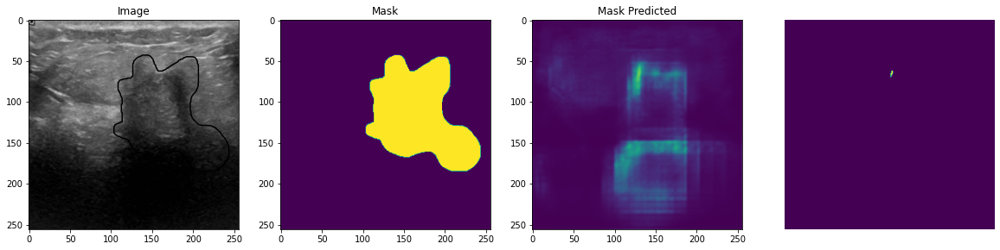

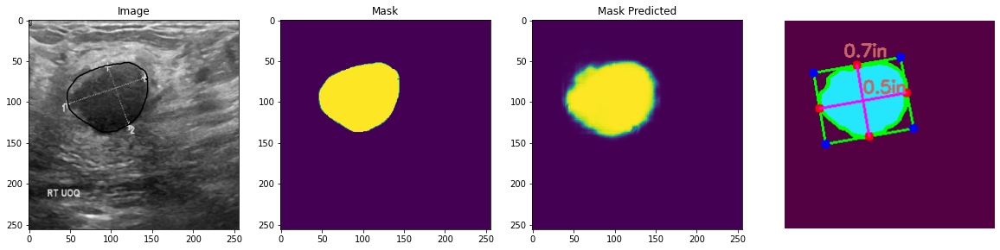

test image: 55
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.348876953125
area ratio of mask predicted by model 1.6959366391184574
[[42. 20.]
 [84. 20.]
 [84. 40.]
 [42. 40.]]
dimA 0.12738853503184713
dimB 0.267515923566879


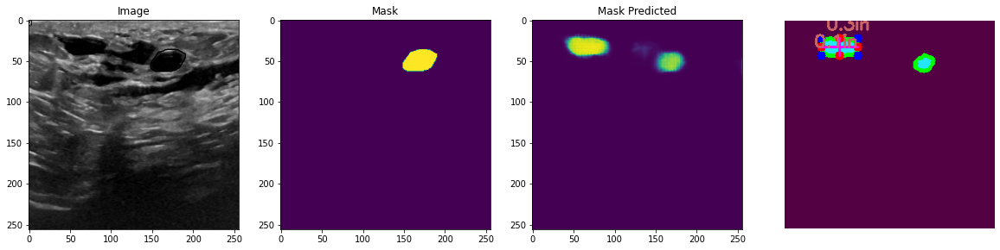

test image: 56
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 10.7513427734375
area ratio of mask predicted by model 10.053374655647383
[[ 43.  57.]
 [141.  46.]
 [150. 123.]
 [ 51. 134.]]
dimA 0.4934250650907714
dimB 0.6312885989338151


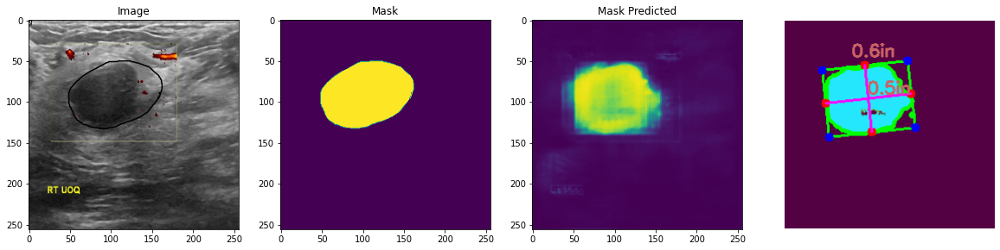

test image: 57
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.3974609375
area ratio of mask predicted by model 6.7957988980716255
[[ 60.  32.]
 [138.  32.]
 [138.  96.]
 [ 60.  96.]]
dimA 0.40764331210191085
dimB 0.4968152866242038


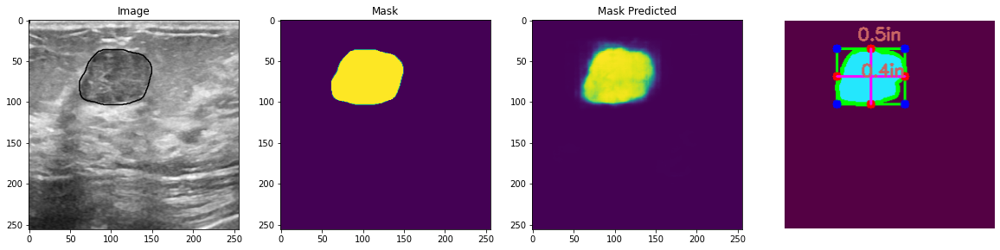

test image: 58
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.14593505859375
area ratio of mask predicted by model 0.0068870523415977955
test image: 59
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.80401611328125
area ratio of mask predicted by model 3.4693526170798896
[[137.  31.]
 [176.  70.]
 [138. 108.]
 [ 99.  69.]]
dimA 0.34229372847246886
dimB 0.3513014581691128


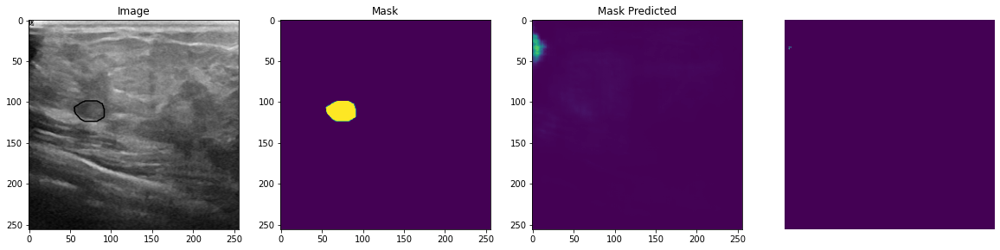

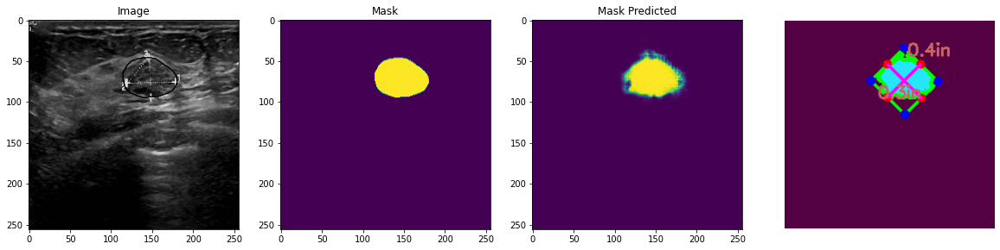

test image: 60
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 21.4752197265625
area ratio of mask predicted by model 34.14084022038568
[[  1.  67.]
 [240.  63.]
 [242. 159.]
 [  2. 164.]]
dimA 0.6147239320189674
dimB 1.5257469544179254


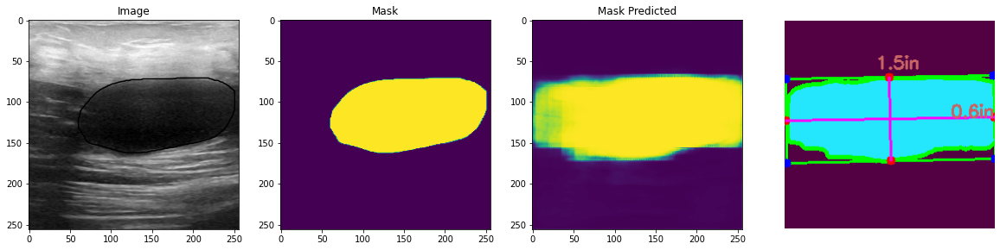

test image: 61
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 17.39349365234375
area ratio of mask predicted by model 19.707300275482094
[[ 25.  55.]
 [127.  55.]
 [127. 149.]
 [ 25. 149.]]
dimA 0.5987261146496815
dimB 0.6496815286624203


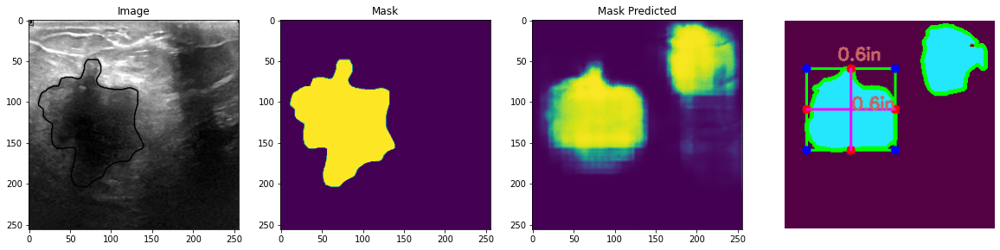

test image: 62
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.4810791015625
area ratio of mask predicted by model 100.0
test image: 63
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 9.98992919921875
area ratio of mask predicted by model 10.65771349862259
[[ 84.  45.]
 [180.  64.]
 [164. 140.]
 [ 68. 121.]]
dimA 0.494687588253442
dimB 0.6233257830758597


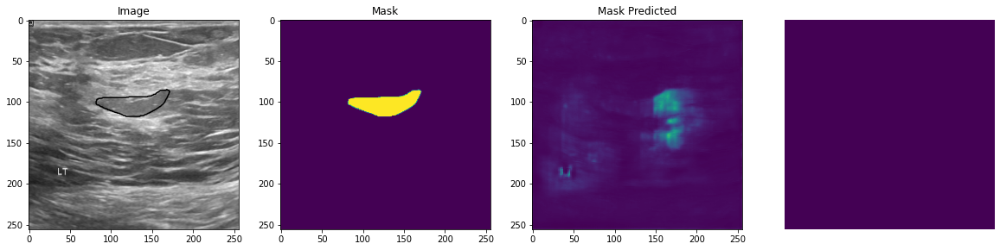

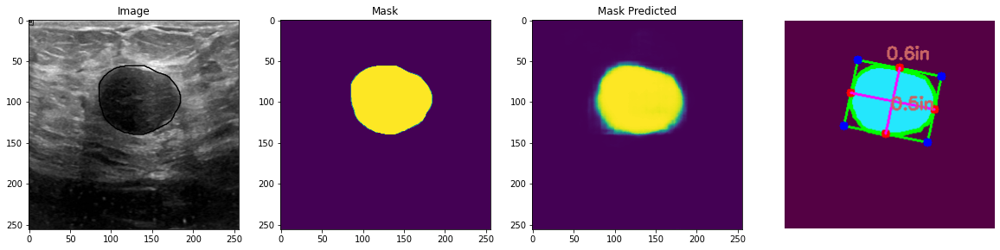

test image: 64
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.06817626953125
area ratio of mask predicted by model 8.24896694214876
[[-15. 157.]
 [ 18.  98.]
 [ 48. 116.]
 [ 14. 174.]]
dimA 0.2184722660655095
dimB 0.4293815718221442


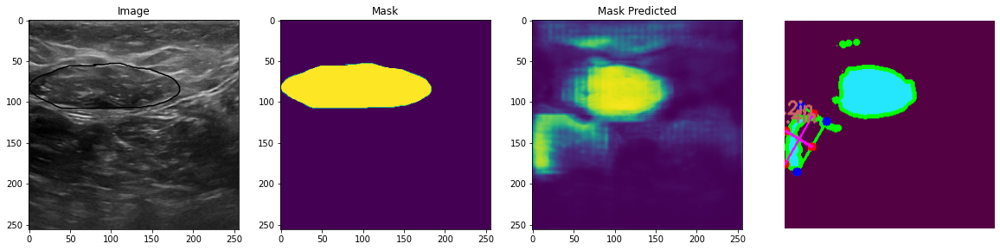

test image: 65
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.787109375
area ratio of mask predicted by model 5.53202479338843
[[159.  30.]
 [241.  30.]
 [241.  77.]
 [159.  77.]]
dimA 0.29936305732484075
dimB 0.5222929936305732


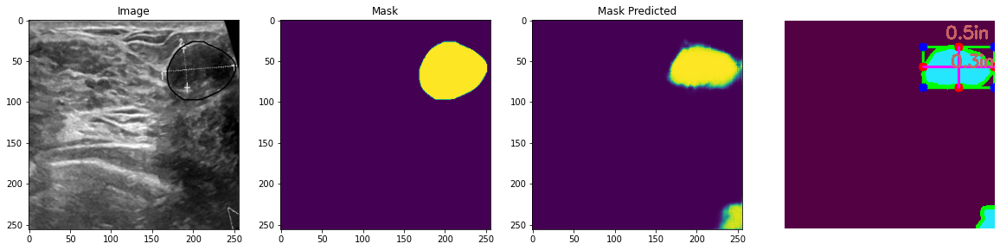

test image: 66
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.80487060546875
area ratio of mask predicted by model 6.1690771349862255
[[ 48.  93.]
 [153.  75.]
 [161. 120.]
 [ 56. 138.]]
dimA 0.29111834094334876
dimB 0.6785457670534282


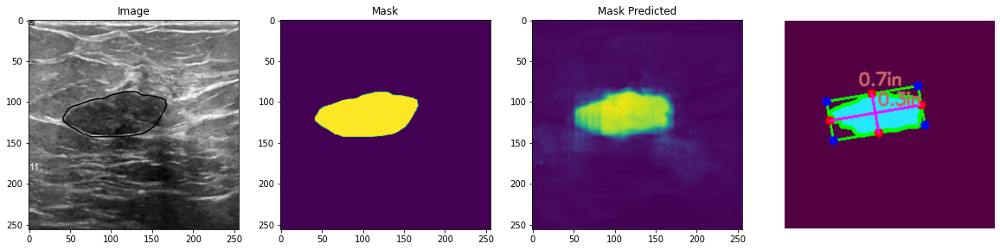

test image: 67
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 15.73333740234375
area ratio of mask predicted by model 10.547520661157025
[[ 80.  49.]
 [160.  49.]
 [160. 156.]
 [ 80. 156.]]
dimA 0.6815286624203821
dimB 0.5095541401273885


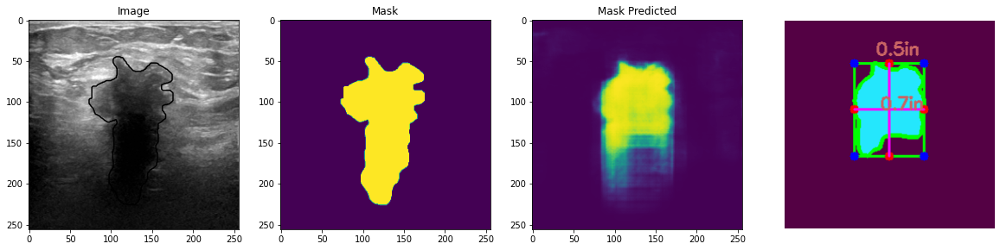

test image: 68
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.06787109375
area ratio of mask predicted by model 7.6411845730027546
[[ 79.  46.]
 [171.  34.]
 [179.  97.]
 [ 88. 110.]]
dimA 0.4080660626383172
dimB 0.5882157845907862


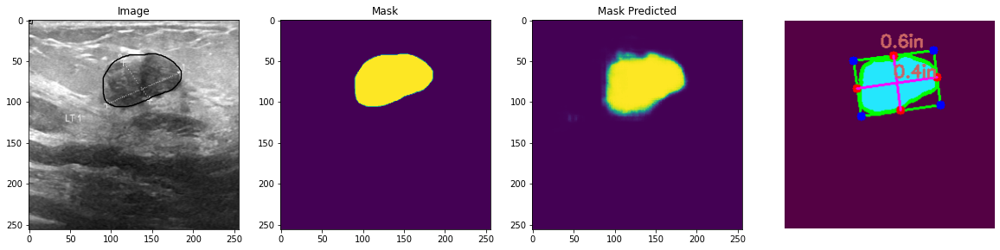

test image: 69
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.87103271484375
area ratio of mask predicted by model 2.0334022038567494
[[-5. 14.]
 [25. -2.]
 [36. 18.]
 [ 5. 34.]]
dimA 0.14387715921116584
dimB 0.21937567005470732


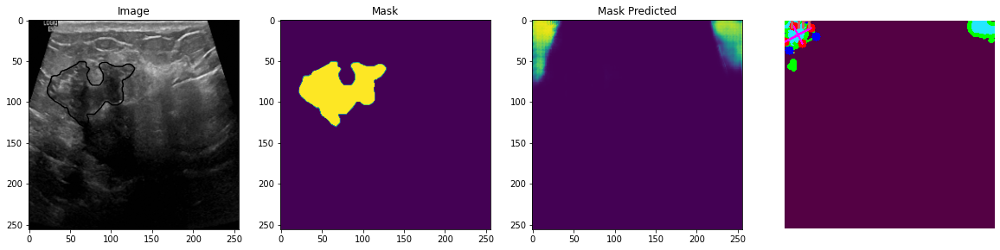

test image: 70
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.685546875
area ratio of mask predicted by model 3.0733471074380168
[[  4. 149.]
 [ 39. 149.]
 [ 39. 168.]
 [  4. 168.]]
dimA 0.12101910828025478
dimB 0.2229299363057325


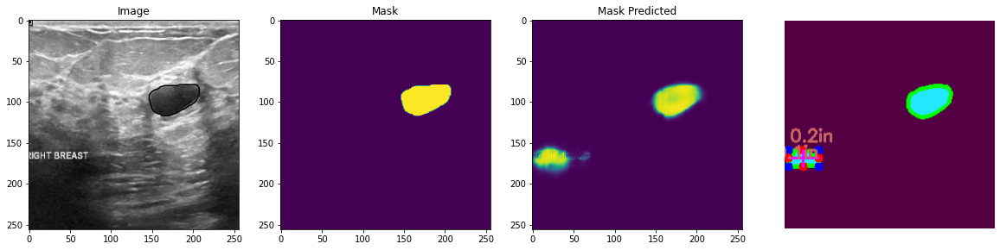

test image: 71
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.58221435546875
area ratio of mask predicted by model 5.347796143250689
[[ 64.  -4.]
 [148.  29.]
 [130.  73.]
 [ 46.  39.]]
dimA 0.299853913881692
dimB 0.5760106837916317


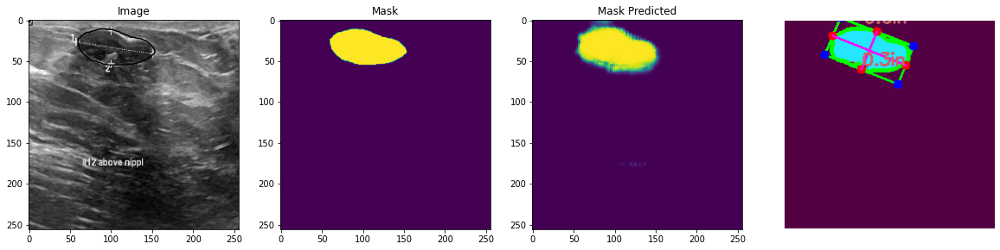

test image: 72
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 40.0634765625
area ratio of mask predicted by model 10.459710743801654
[[  0. 151.]
 [  0. 151.]
 [  0. 151.]
 [  0. 151.]]
dimA 0.0
dimB 0.0


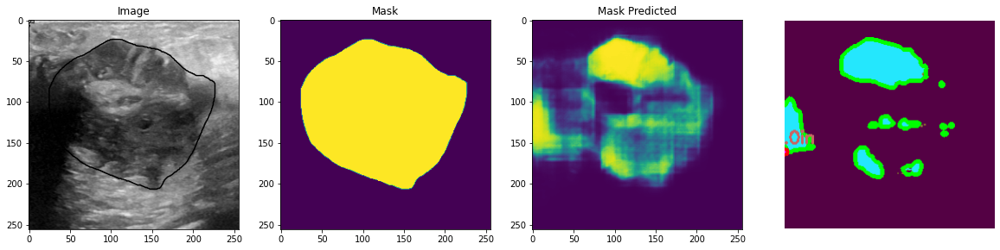

test image: 73
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 17.3828125
area ratio of mask predicted by model 22.78753443526171
[[ 50.  59.]
 [167.  45.]
 [185. 198.]
 [ 68. 212.]]
dimA 0.9812432160357529
dimB 0.7505390438498564


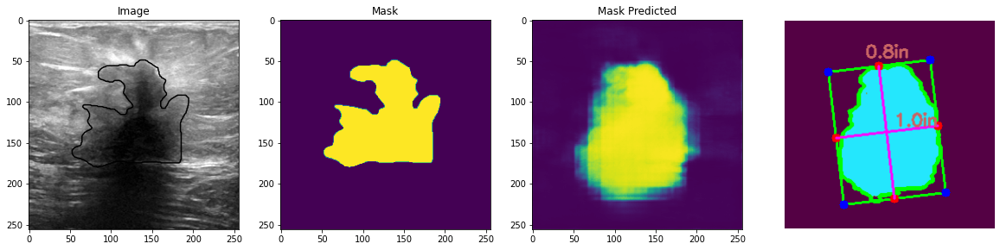

test image: 74
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.921142578125
area ratio of mask predicted by model 12.737603305785125
[[ 20.  49.]
 [159.   3.]
 [182.  71.]
 [ 42. 117.]]
dimA 0.4562150542753876
dimB 0.9355959439715844


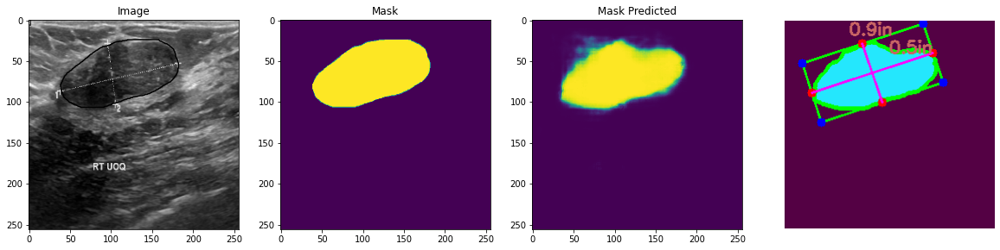

test image: 75
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.7415771484375
area ratio of mask predicted by model 0.456267217630854
test image: 76
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.6151123046875
area ratio of mask predicted by model 8.476239669421487
[[  9.  26.]
 [ 83.  26.]
 [ 83. 109.]
 [  9. 109.]]
dimA 0.5286624203821656
dimB 0.4713375796178344


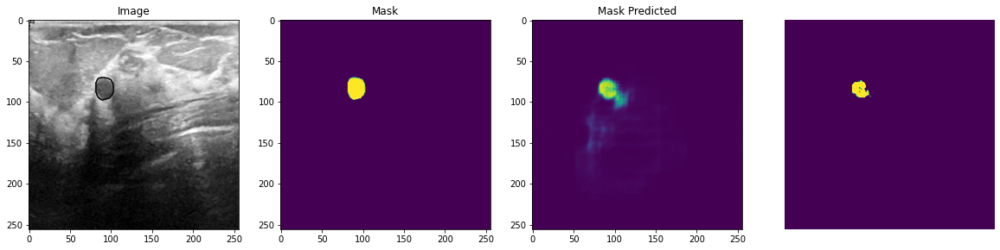

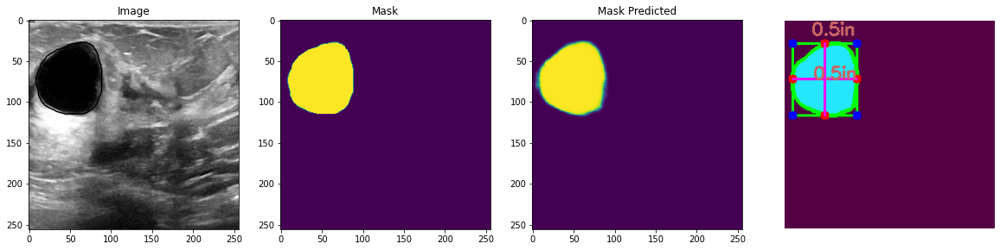

test image: 77
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.57470703125
area ratio of mask predicted by model 1.1707988980716253
[[192.  86.]
 [228.  91.]
 [225. 116.]
 [189. 111.]]
dimA 0.16037806766897034
dimB 0.23150040567371016


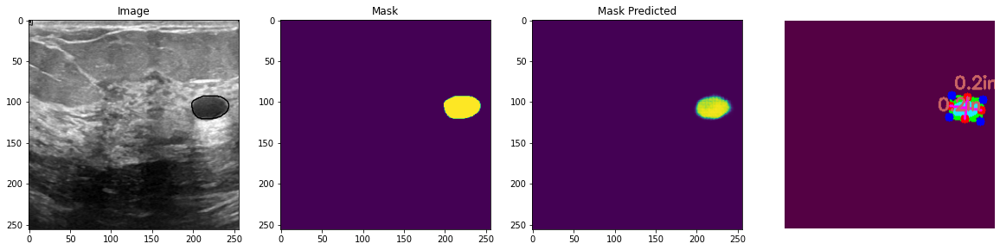

test image: 78
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.494140625
area ratio of mask predicted by model 7.804752066115703
[[ 75. 129.]
 [160. 116.]
 [173. 203.]
 [ 88. 216.]]
dimA 0.5602923725159044
dimB 0.5476966325275328


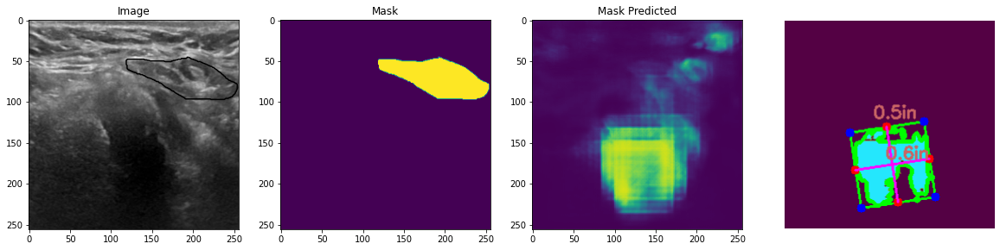

test image: 79
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 25.89874267578125
area ratio of mask predicted by model 26.143250688705233
[[116.  34.]
 [220. 126.]
 [119. 241.]
 [ 14. 149.]]
dimA 0.9769805803616722
dimB 0.8867982935463118


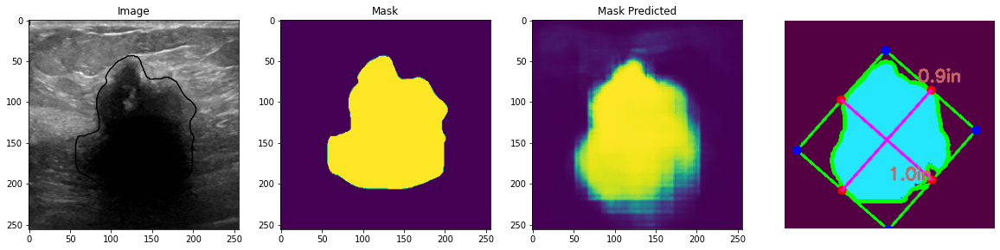

test image: 80
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.64422607421875
area ratio of mask predicted by model 7.586088154269972
[[ 94.  52.]
 [188.  33.]
 [201.  95.]
 [107. 114.]]
dimA 0.40349199910093897
dimB 0.6108343350962285


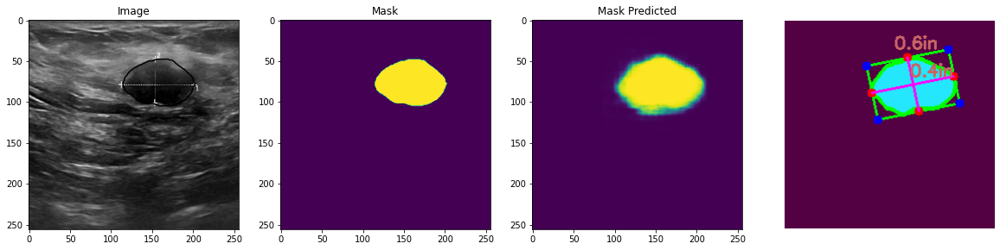

test image: 81
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.76678466796875
area ratio of mask predicted by model 15.123966942148762
[[ 63.  -8.]
 [187.  80.]
 [137. 150.]
 [ 13.  62.]]
dimA 0.5479188068180018
dimB 0.9684880412100999


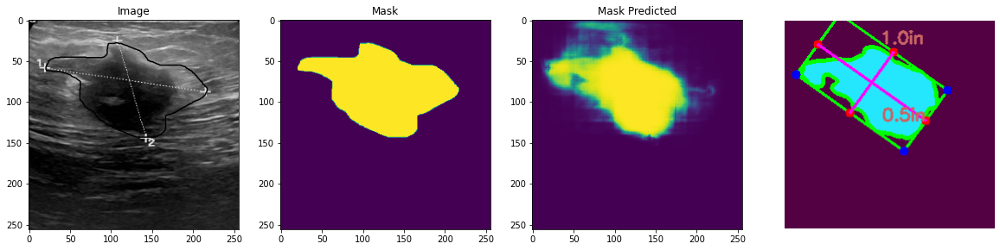

test image: 82
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.26495361328125
area ratio of mask predicted by model 1.0623278236914602
[[ 98.  92.]
 [129.  96.]
 [126. 121.]
 [ 95. 117.]]
dimA 0.16037806766897034
dimB 0.19908916698200999


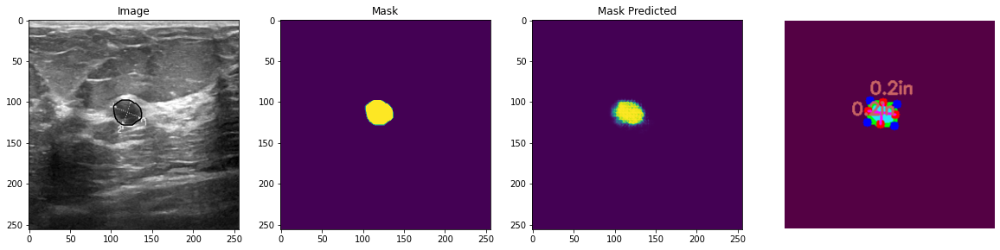

test image: 83
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.1937255859375
area ratio of mask predicted by model 8.477961432506886
[[ 86.  15.]
 [182.  29.]
 [173.  94.]
 [ 76.  80.]]
dimA 0.4184112260387095
dimB 0.6210844322984522


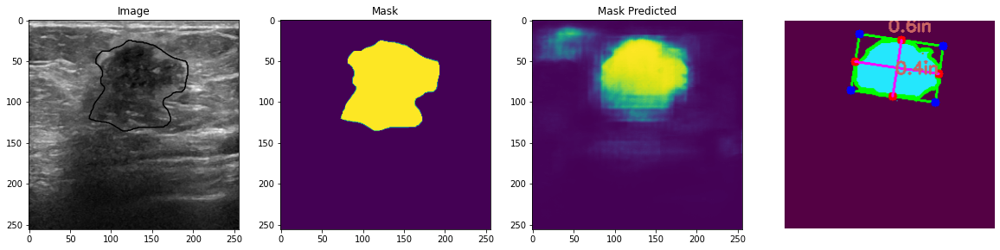

test image: 84
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.396728515625
area ratio of mask predicted by model 0.3323002754820936
test image: 85
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 2.01263427734375
area ratio of mask predicted by model 1.8956611570247934
[[ 67.  57.]
 [103.  57.]
 [103.  96.]
 [ 67.  96.]]
dimA 0.2484076433121019
dimB 0.22929936305732485


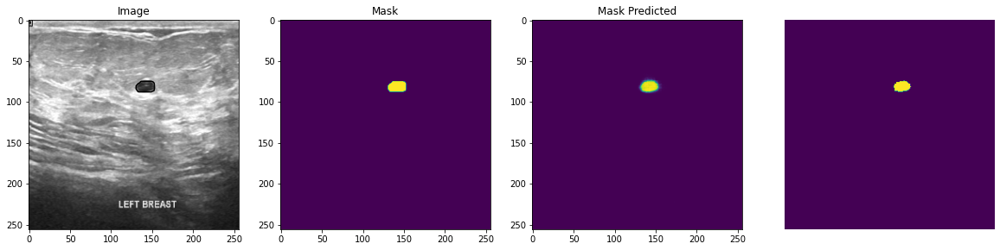

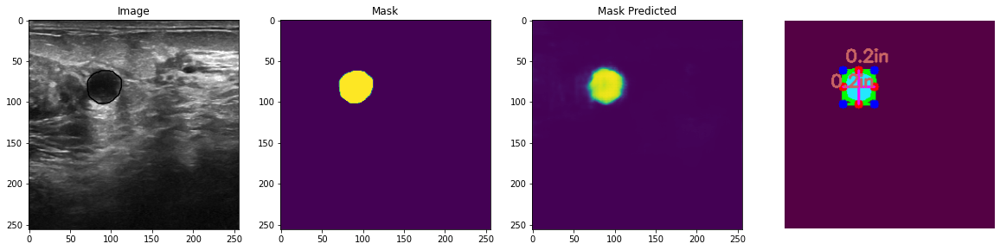

test image: 86
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.2777099609375
area ratio of mask predicted by model 0.07747933884297521
test image: 87
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.3111572265625
area ratio of mask predicted by model 1.6356749311294765
[[ 83.  20.]
 [114.  47.]
 [ 90.  75.]
 [ 59.  49.]]
dimA 0.23731991748485773
dimB 0.25976408999242423


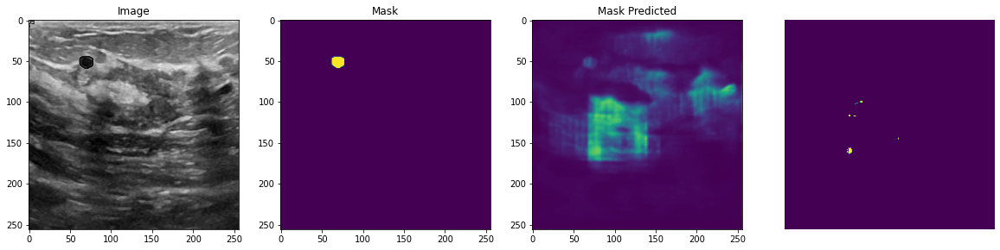

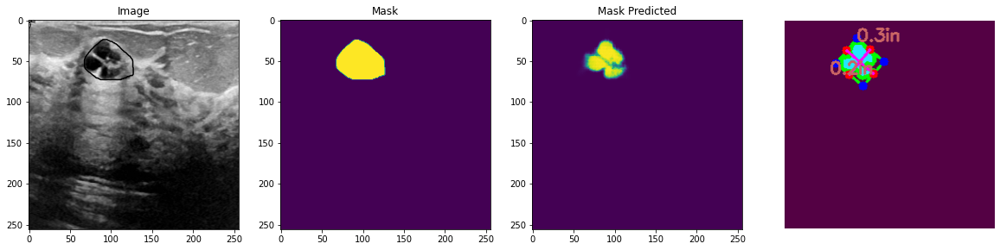

test image: 88
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.01776123046875
area ratio of mask predicted by model 0.778236914600551
test image: 89
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.02581787109375
area ratio of mask predicted by model 1.461776859504132
[[115.  19.]
 [155.  30.]
 [147.  60.]
 [107.  49.]]
dimA 0.1977601872135035
dimB 0.26423526767759925


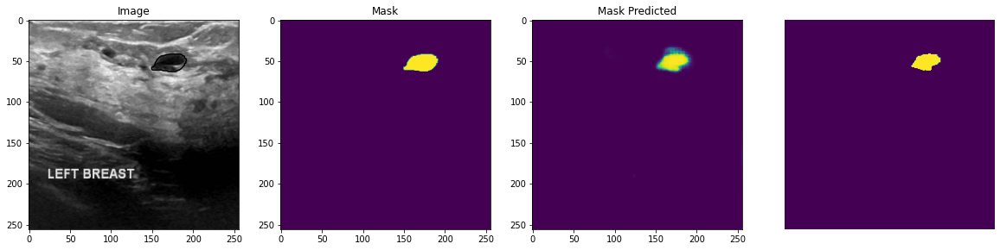

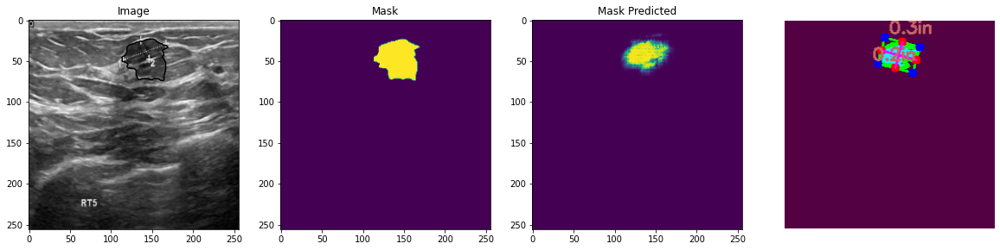

test image: 90
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.6072998046875
area ratio of mask predicted by model 0.49931129476584024
test image: 91
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.6610107421875
area ratio of mask predicted by model 5.819559228650138
[[19. 28.]
 [98. 28.]
 [98. 83.]
 [19. 83.]]
dimA 0.3503184713375796
dimB 0.5031847133757962


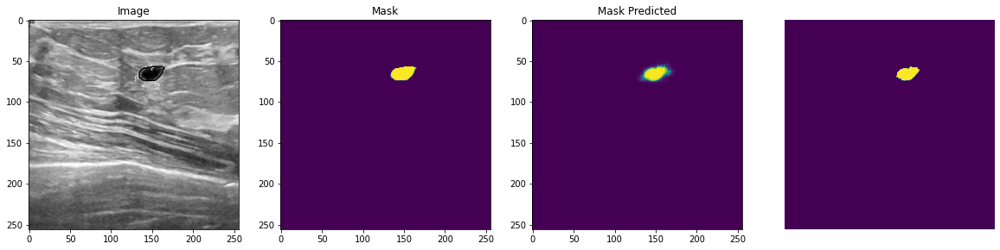

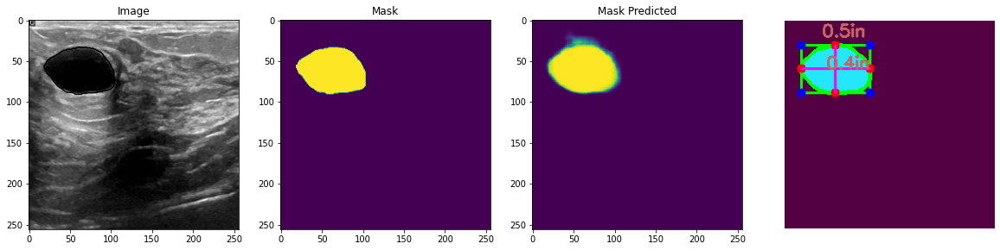

test image: 92
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.959228515625
area ratio of mask predicted by model 1.6098484848484849
[[44. 47.]
 [84. 47.]
 [84. 77.]
 [44. 77.]]
dimA 0.1910828025477707
dimB 0.25477707006369427


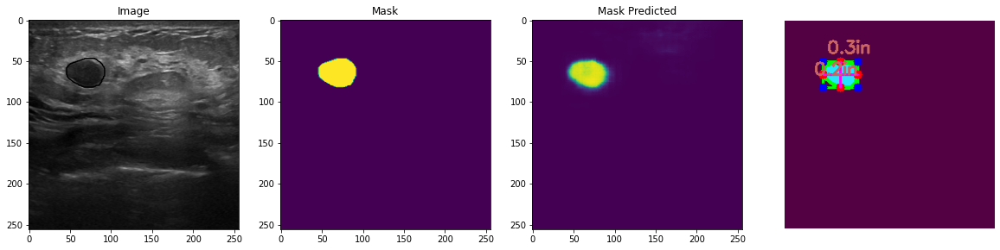

test image: 93
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.046630859375
area ratio of mask predicted by model 3.443526170798898
[[ 92. 135.]
 [183. 115.]
 [189. 147.]
 [ 99. 166.]]
dimA 0.2048639749818521
dimB 0.5896623884239167


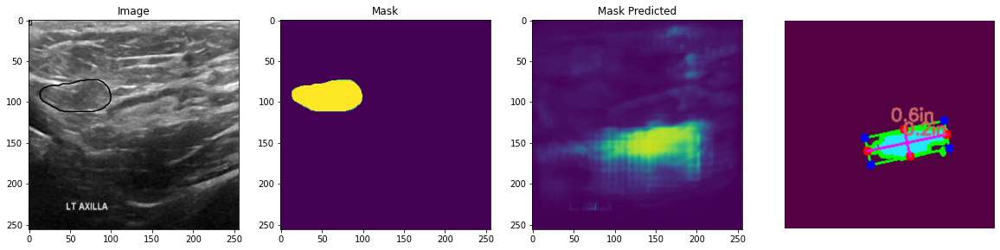

test image: 94
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 12.16888427734375
area ratio of mask predicted by model 11.537534435261708
[[ 55.  11.]
 [150.  11.]
 [150.  98.]
 [ 55.  98.]]
dimA 0.554140127388535
dimB 0.6050955414012739


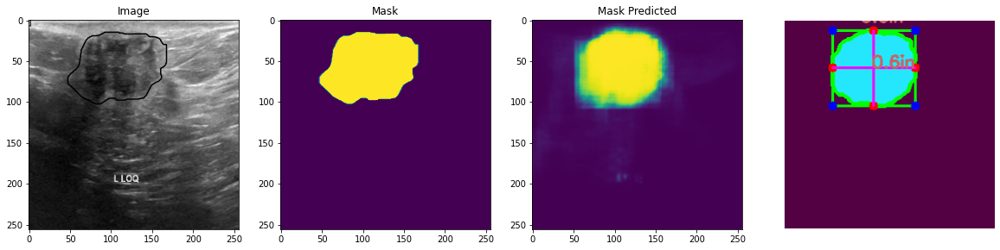

test image: 95
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 8.20770263671875
area ratio of mask predicted by model 0.7558539944903581
test image: 96
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.5035400390625
area ratio of mask predicted by model 0.6043388429752066
test image: 97
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.86358642578125
area ratio of mask predicted by model 0.831611570247934
test image: 98
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.8585205078125
area ratio of mask predicted by model 1.5840220385674932
[[121.  62.]
 [152.  70.]
 [143. 105.]
 [112.  97.]]
dimA 0.23018230572729492
dimB 0.20392115405837097


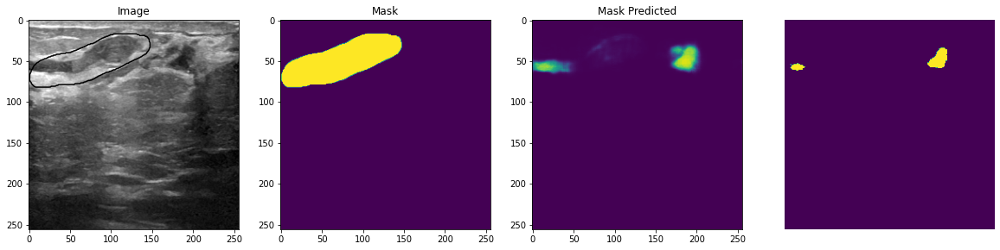

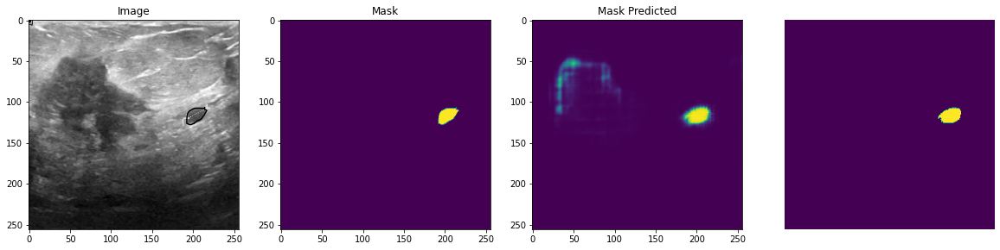

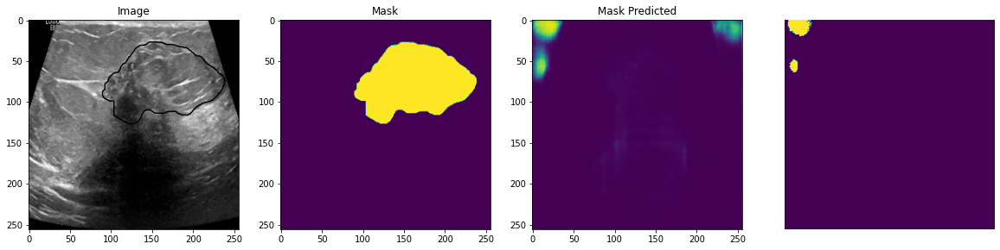

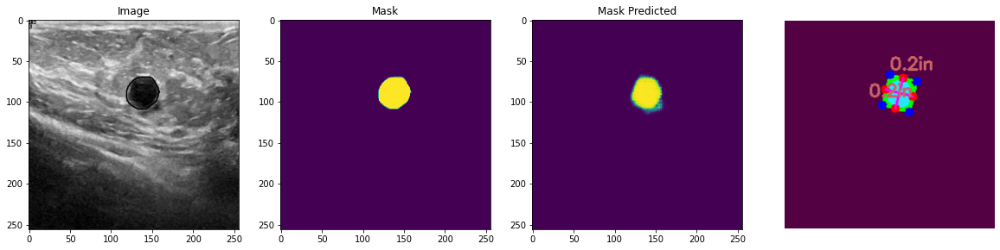

test image: 99
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.75836181640625
area ratio of mask predicted by model 7.224517906336088
[[ 48. 110.]
 [ 51. 109.]
 [ 53. 117.]
 [ 50. 118.]]
dimA 0.05252363854290013
dimB 0.02014189592463936


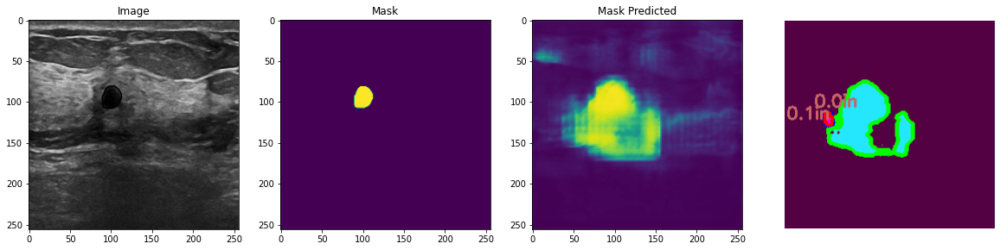

test image: 100
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.24188232421875
area ratio of mask predicted by model 22.415633608815426
[[100.  28.]
 [207.  85.]
 [138. 217.]
 [ 30. 160.]]
dimA 0.950182065311509
dimB 0.775011630954485


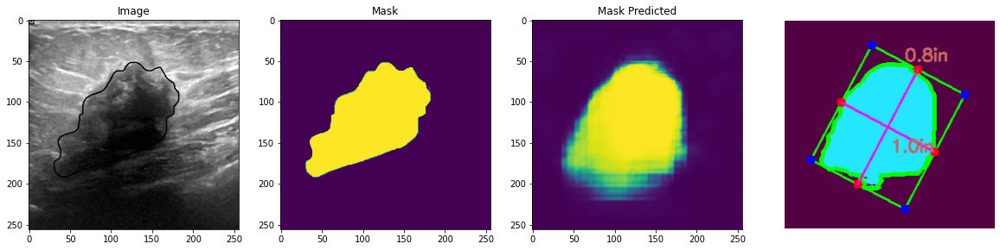

test image: 101
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.6131591796875
area ratio of mask predicted by model 2.518939393939394
[[131.  17.]
 [194.  17.]
 [194.  44.]
 [131.  44.]]
dimA 0.17197452229299362
dimB 0.4012738853503185


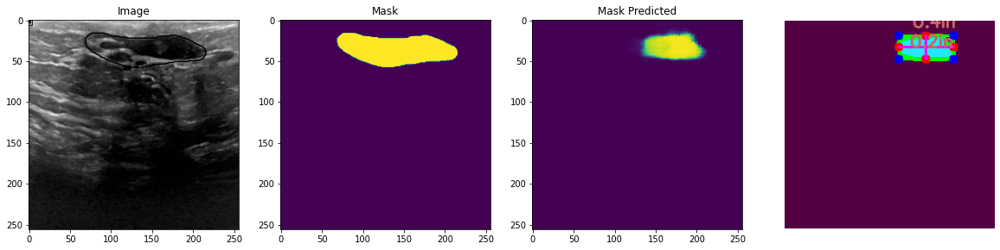

test image: 102
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.860595703125
area ratio of mask predicted by model 0.6387741046831955
test image: 103
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.61492919921875
area ratio of mask predicted by model 0.4838154269972451
test image: 104
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.53656005859375
area ratio of mask predicted by model 0.012052341597796144
test image: 105
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.125
area ratio of mask predicted by model 3.0785123966942147
[[124.  68.]
 [173.  51.]
 [186.  91.]
 [138. 108.]]
dimA 0.268896196532633
dimB 0.32734454089892323


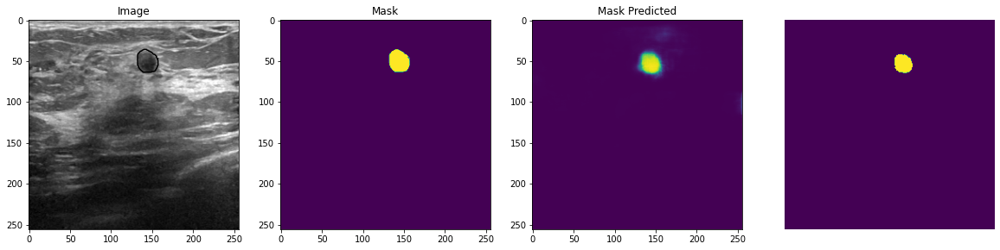

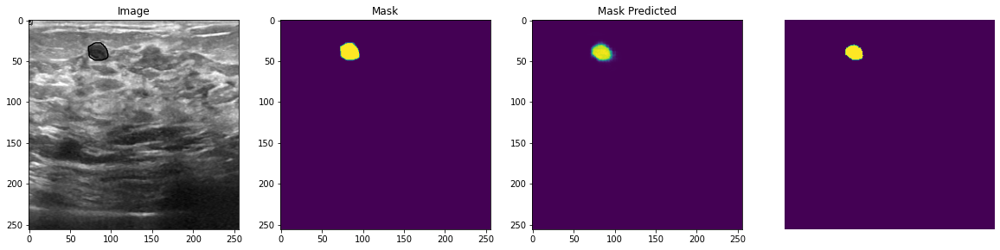

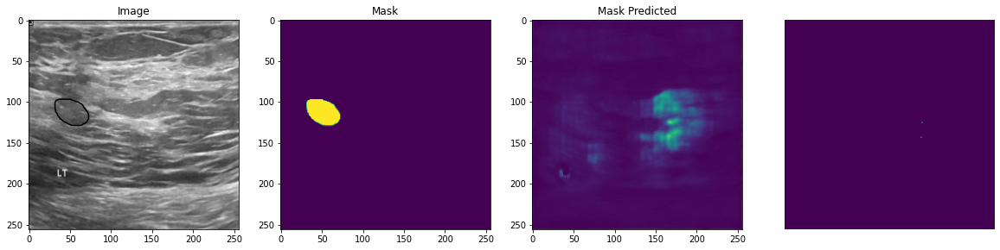

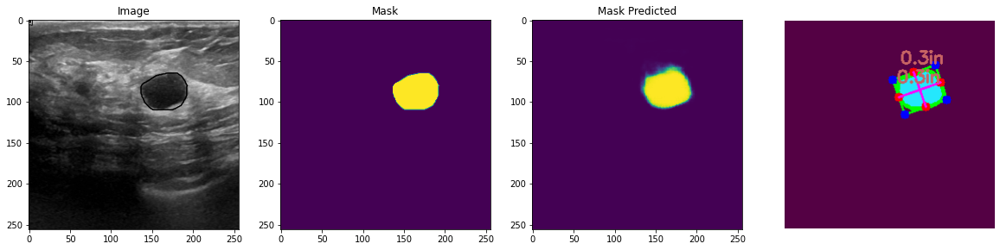

test image: 106
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.9805908203125
area ratio of mask predicted by model 24.22692837465565
[[-9. 60.]
 [36. 39.]
 [50. 69.]
 [ 4. 90.]]
dimA 0.20953865158720994
dimB 0.31918709376730725


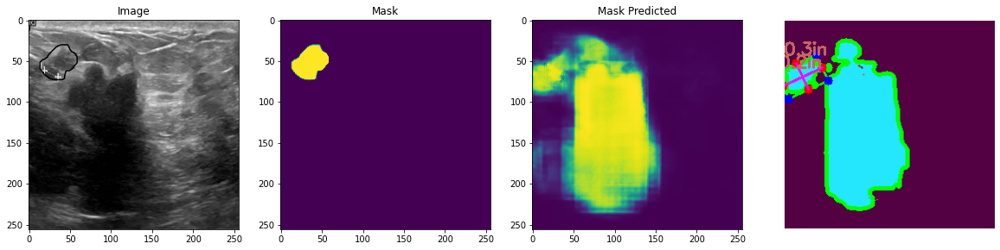

test image: 107
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.20391845703125
area ratio of mask predicted by model 0.8849862258953168
test image: 108
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.18145751953125
area ratio of mask predicted by model 1.1070936639118458
[[ 83.  60.]
 [114.  60.]
 [114.  91.]
 [ 83.  91.]]
dimA 0.19745222929936307
dimB 0.19745222929936307


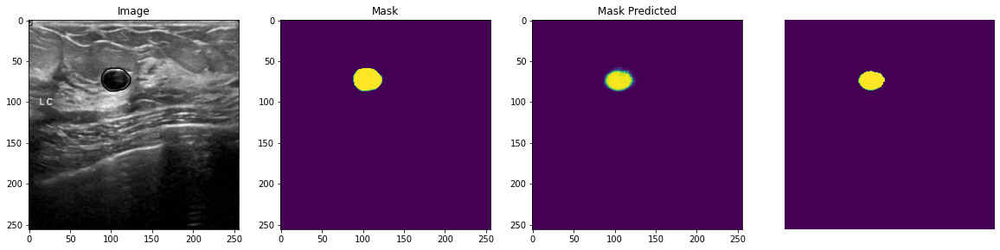

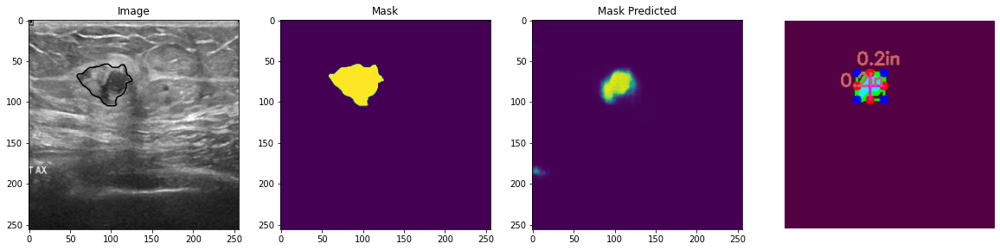

test image: 109
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 14.63623046875
area ratio of mask predicted by model 4.676308539944904
[[ 82.  38.]
 [145.  44.]
 [140. 104.]
 [ 77.  98.]]
dimA 0.3834902732099457
dimB 0.40308961356170037


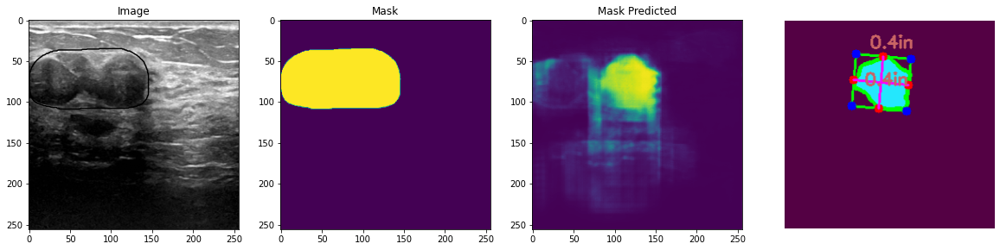

test image: 110
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 18.5211181640625
area ratio of mask predicted by model 7.481060606060606
[[124.  51.]
 [188.  43.]
 [199. 133.]
 [135. 141.]]
dimA 0.577514205989779
dimB 0.4108156814419643


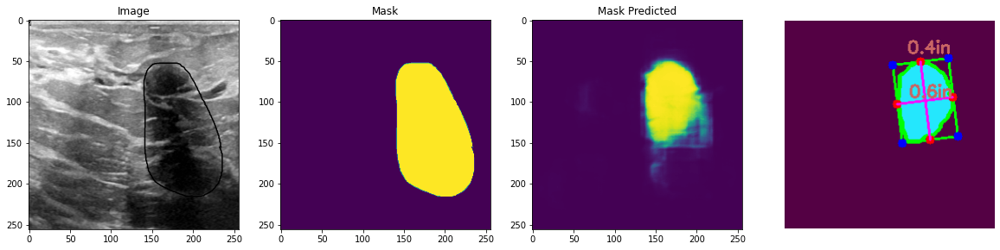

test image: 111
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.72247314453125
area ratio of mask predicted by model 1.640840220385675
[[36. 59.]
 [82. 61.]
 [81. 81.]
 [35. 80.]]
dimA 0.13072850797308147
dimB 0.2931493632093833


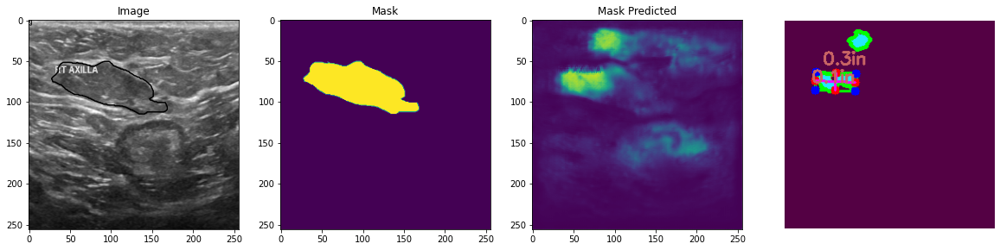

test image: 112
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 7.15179443359375
area ratio of mask predicted by model 7.506887052341598
[[ 52.  53.]
 [140.  28.]
 [157.  88.]
 [ 70. 113.]]
dimA 0.3980891719745223
dimB 0.5796265835414425


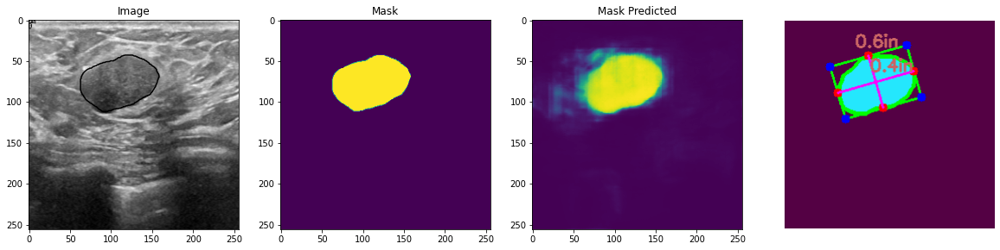

test image: 113
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 6.976318359375
area ratio of mask predicted by model 5.198002754820936
[[ 95.  41.]
 [160.  73.]
 [134. 127.]
 [ 69.  96.]]
dimA 0.3846126539597296
dimB 0.460067093692881


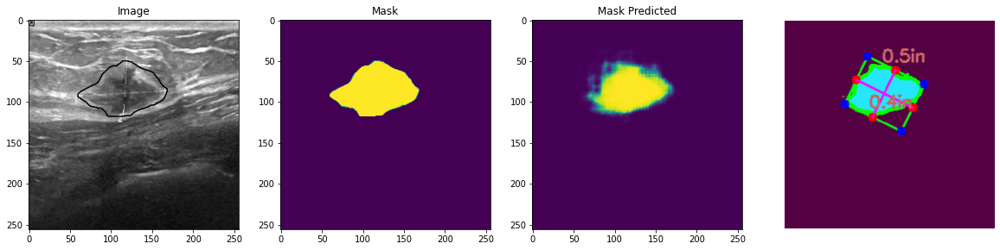

test image: 114
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 4.64019775390625
area ratio of mask predicted by model 4.755509641873278
[[116.  24.]
 [180.  24.]
 [180.  80.]
 [116.  80.]]
dimA 0.35668789808917195
dimB 0.40764331210191085


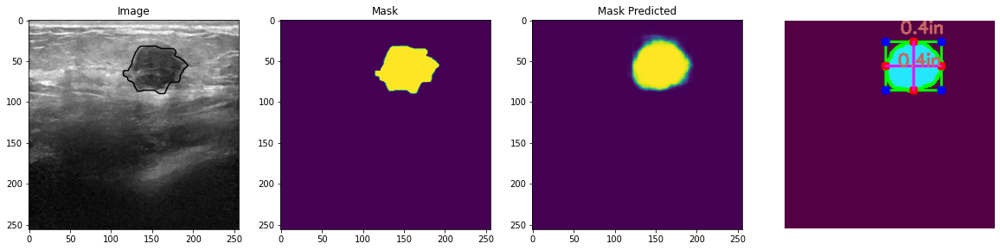

test image: 115
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.555419921875
area ratio of mask predicted by model 0.0809228650137741
test image: 116
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.15966796875
area ratio of mask predicted by model 1.0072314049586777
[[ 98.  95.]
 [128.  95.]
 [128. 120.]
 [ 98. 120.]]
dimA 0.1592356687898089
dimB 0.1910828025477707


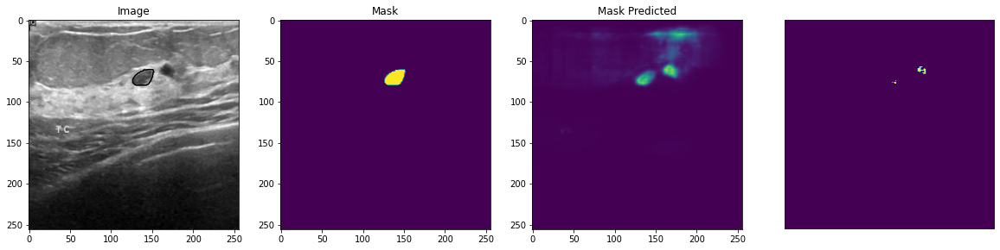

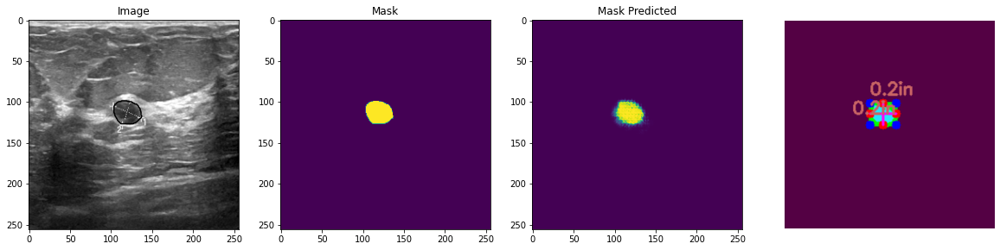

test image: 117
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.171875
area ratio of mask predicted by model 0.13601928374655647
test image: 118
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.50506591796875
area ratio of mask predicted by model 1.127754820936639
[[47. 15.]
 [69. 15.]
 [69. 21.]
 [47. 21.]]
dimA 0.03821656050955414
dimB 0.14012738853503184


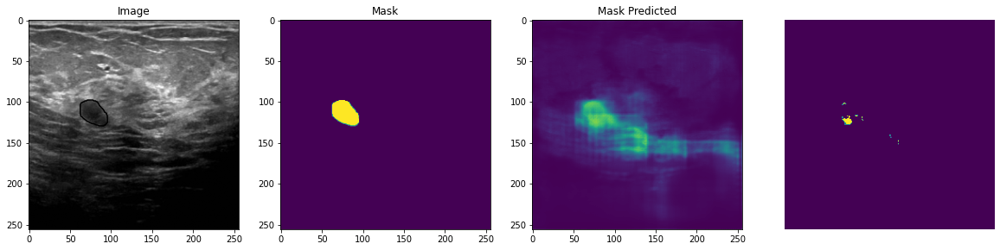

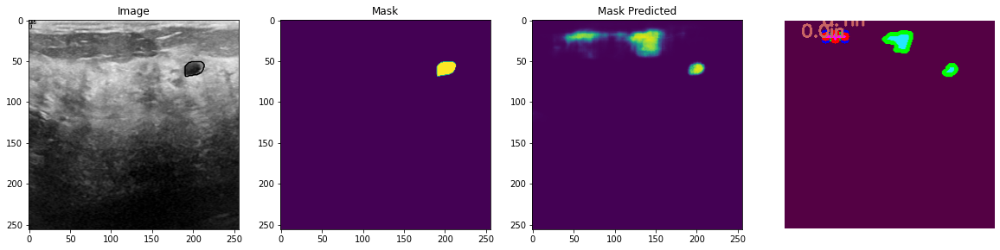

test image: 119
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 31.07757568359375
area ratio of mask predicted by model 28.06990358126722
[[ 13. 121.]
 [122.  31.]
 [222. 153.]
 [112. 242.]]
dimA 1.0002738072955037
dimB 0.9007842292561405


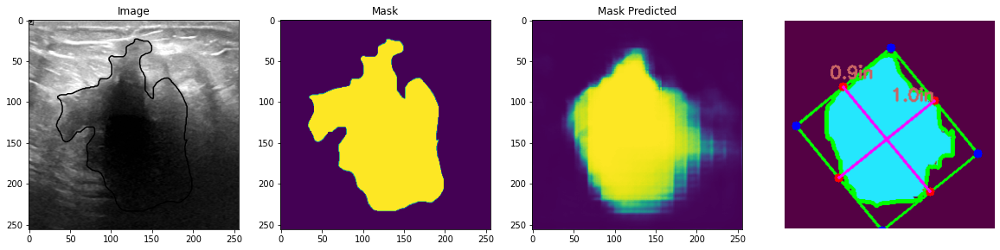

test image: 120
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 1.23443603515625
area ratio of mask predicted by model 0.015495867768595042
test image: 121
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 19.74334716796875
area ratio of mask predicted by model 9.962121212121213
[[  2.   2.]
 [ 83.   2.]
 [ 83. 156.]
 [  2. 156.]]
dimA 0.9808917197452229
dimB 0.5159235668789809


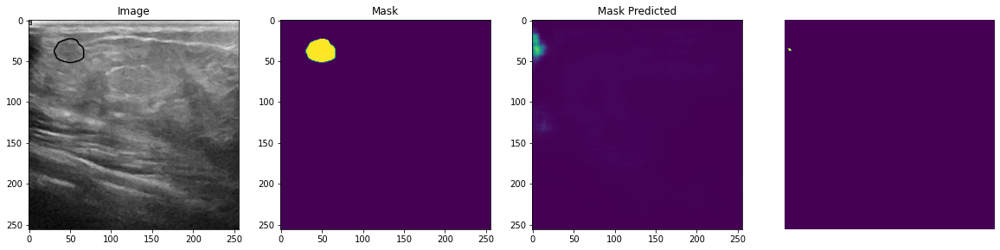

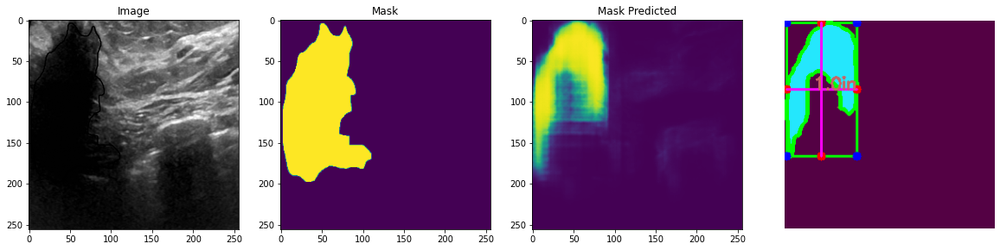

test image: 122
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 19.43817138671875
area ratio of mask predicted by model 17.30888429752066
[[ 54.  37.]
 [175.  37.]
 [175. 147.]
 [ 54. 147.]]
dimA 0.7006369426751592
dimB 0.7707006369426752


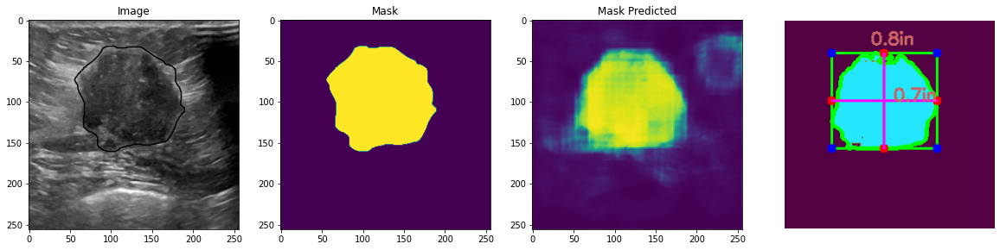

test image: 123
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.98724365234375
area ratio of mask predicted by model 0.5595730027548209
test image: 124
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.1483154296875
area ratio of mask predicted by model 5.6921487603305785
[[ 85.  79.]
 [166.  79.]
 [166. 131.]
 [ 85. 131.]]
dimA 0.33121019108280253
dimB 0.5159235668789809


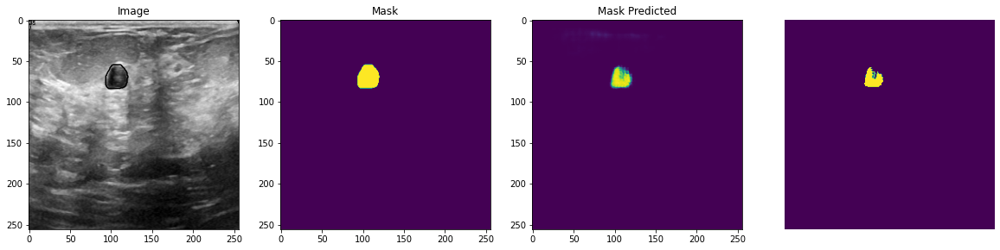

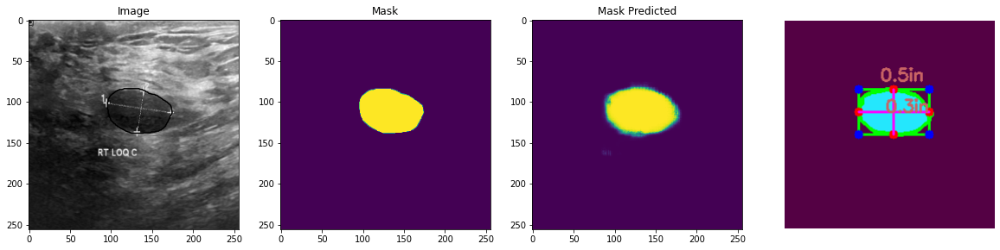

test image: 125
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 11.9903564453125
area ratio of mask predicted by model 15.268595041322314
[[  9.  97.]
 [ 35.  99.]
 [ 29. 173.]
 [  2. 171.]]
dimA 0.47315238500860185
dimB 0.16926983778239887


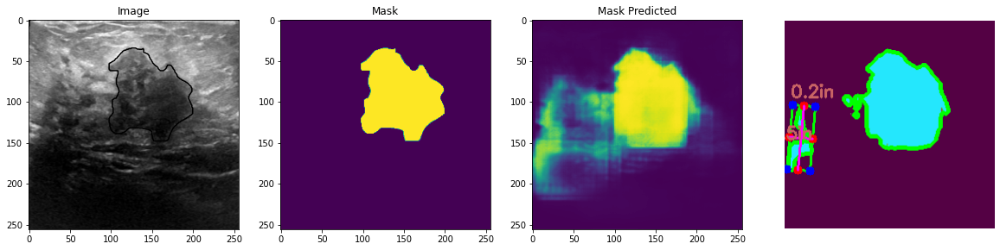

test image: 126
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 5.87005615234375
area ratio of mask predicted by model 6.425619834710744
[[128.  22.]
 [211.  26.]
 [207.  93.]
 [125.  89.]]
dimA 0.4273334753374483
dimB 0.5260949858295307


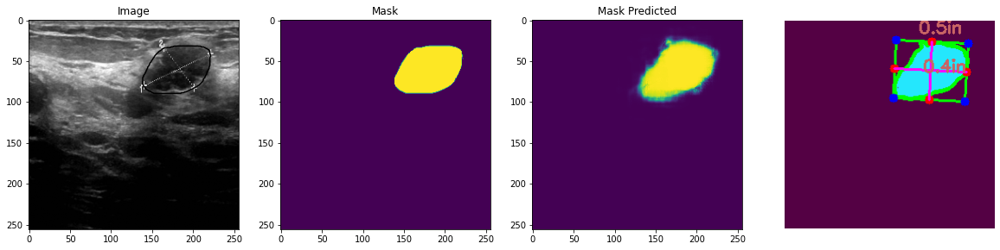

test image: 127
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 45.69244384765625
area ratio of mask predicted by model 2.165977961432507
[[ 7.  0.]
 [43.  0.]
 [43. 24.]
 [ 7. 24.]]
dimA 0.15286624203821655
dimB 0.22929936305732485


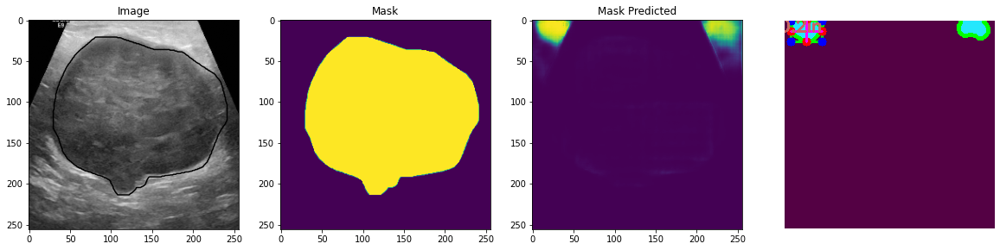

test image: 128
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 0.95062255859375
area ratio of mask predicted by model 0.778236914600551
test image: 129
mask image is:  AxesImage(471.13,90;242.609x543.6)
area ratio of ground truth 3.0487060546875
area ratio of mask predicted by model 1.7131542699724518
[[ 98.  38.]
 [109.  39.]
 [108.  52.]
 [ 96.  51.]]
dimA 0.08335192565797707
dimB 0.07352481771092481


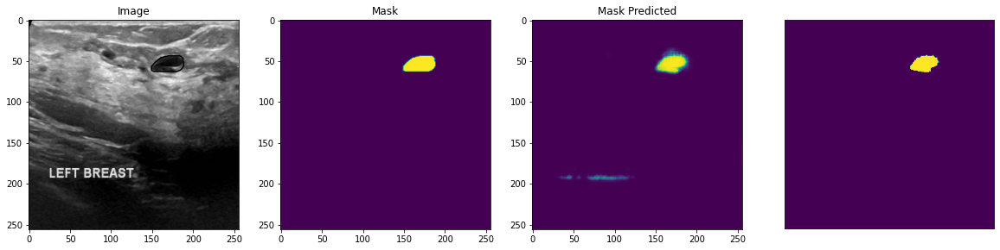

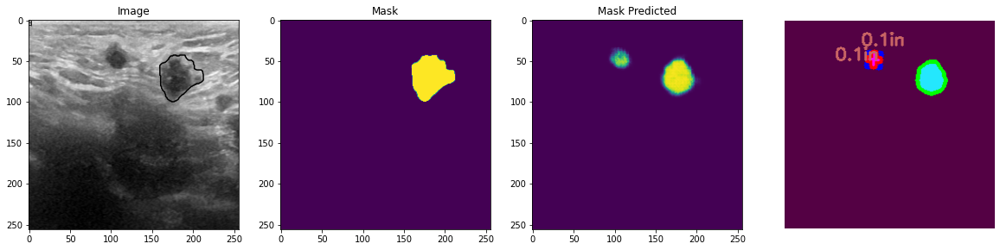

In [80]:

for i in range (0,len(X_valid)):
    plot_sample4(X_valid, y_valid, preds_test, preds_test_t,i)

df_final.to_csv(r'C:\Users\Jaya Tiwari\OneDrive\Documents\final_prj\base_unet.csv')

In [81]:
# create a dataframe from the lists
df= pd.DataFrame(data=zip(index,area_ratio_mask,area_ratio_pred_mask,length,width,top_right,top_left,bottom_right,bottom_left), 
                 columns=['index','white_pixel_area_ratio_mask','white_pixel_area_ratio_pred_mask','length_recBox',
'width_recBox',
'top_right_coor_rec',
'top_left_coor_rec',
'bottom_right_coor_rec',
'bottom_left_coor_rec'])

In [82]:
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]"
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]"
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]"
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]"
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]"
...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]"
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]"
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]"
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]"


In [ ]:
# df.sort_values(by = 'white_pixel_area_ratio_pred_mask', inplace = True)

In [ ]:
df

In [ ]:
# Differential Analysis steps

In [83]:
df['diff_area_ratio_pred'] = df['white_pixel_area_ratio_pred_mask']- df['white_pixel_area_ratio_pred_mask'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",NaN
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152
...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678


In [84]:
df['diff_area_ratio_pred']=df['diff_area_ratio_pred'].replace(to_replace=np.NaN,value=0)
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152
...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678


In [85]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147 entries, 0 to 146
Data columns (total 10 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   index                             147 non-null    int64  
 1   white_pixel_area_ratio_mask       147 non-null    float64
 2   white_pixel_area_ratio_pred_mask  147 non-null    float64
 3   length_recBox                     147 non-null    float64
 4   width_recBox                      147 non-null    float64
 5   top_right_coor_rec                147 non-null    object 
 6   top_left_coor_rec                 147 non-null    object 
 7   bottom_right_coor_rec             147 non-null    object 
 8   bottom_left_coor_rec              147 non-null    object 
 9   diff_area_ratio_pred              147 non-null    float64
dtypes: float64(5), int64(1), object(4)
memory usage: 11.6+ KB


#mask_img = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
index = []
def save_file(X, y, preds, binary_preds, ix=None):
    if ix is None:
        ix = random.randint(0, len(X))
    #print("test image:",ix)
    has_mask = y[ix].max() > 0
    #fig, ax = plt.subplots(1, 1, figsize=(20, 10))
    #cv2.imshow('binary_preds', binary_preds[ix])
    #cv2.imwrite('./thresh.png',binary_preds[ix])
    plt.imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    binary_preds[ix].axis('off')
    plt.savefig(out_path,pad_inches=0)
    image1 = cv2.imread('b.png')
    image1 = np.array(image1)
    image1.shape
    # image1 = cv2.imread('thresh.png')
    len1,wid,tl,tr,bl,br = object_opencv(image1)
    length.append(len)
    width.append(wid)
    top_left.append(tl)
    top_right.append(tr)
    bottom_left.append(bl)
    bottom_right.append(br)
    index.append(i)
    

for i in range (0,len(X_valid)):
    save_file(X_valid, y_valid, preds_test, preds_test_t,ix=i)

def plot_sample2(X, y, preds, binary_preds, ix=None):
    if ix is None:
        ix = random.randint(0, len(X))
    #print("test image:",ix)
    has_mask = y[ix].max() > 0
    #img = y[ix]
    #fig, ax = plt.subplots(1, 4, figsize=(20, 10))
    #ax[0].imshow(X[ix])
    #if has_mask:
    #    ax[0].contour(y[ix].squeeze(), colors='k', levels=[0.5])
    #ax[0].set_title('Image')

    #ax[1].imshow(y[ix].squeeze())
    #print("mask image is: ",ax[1].imshow(y[ix].squeeze()))
    #ax[1].set_title('Mask')
    #len,wid,tl,tr,bl,br = object(y[ix])
    #ratio = mask_ratio(y[ix])
    #print("area ratio of ground truth",ratio)

    #ax[2].imshow(preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[2].set_title('Mask Predicted')
    
    #ax[3].imshow(binary_preds[ix].squeeze(), vmin=0, vmax=1)
    #ax[3].set_title('Mask Predicted binary');
    

    len,wid,tl,tr,bl,br = object_opencv(binary_preds[ix])
    #len,wid,tl,tr,bl,br = object_opencv(binary_preds[ix])
    #print("area ratio of mask predicted by model",ratio1)
    
    length.append(len)
    width.append(wid)
    top_left.append(tl)
    top_right.append(tr)
    bottom_left.append(bl)
    bottom_right.append(br)
    index.append(i)

mask_img = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
index = []
for i in range (0,len(X_valid)):
    plot_sample2(X_valid, y_valid, preds_test, preds_test_t,ix=i)
    

mask_img = []
length = []
width=[]
top_right=[]
top_left =[]
bottom_right = []
bottom_left = []
for img in glob.glob("C://Users//Jaya Tiwari//OneDrive//Documents//final_prj//mask_img_diff_ana//*.png"):
    image= cv2.imread(img)
    mask_img.append(img)
    len,wid,tl,tr,bl,br = object(image)
    length.append(len)
    width.append(wid)
    top_left.append(tl)
    top_right.append(tr)
    bottom_left.append(bl)
    bottom_right.append(br)

In [86]:
import pandas as pd

In [87]:
# calculating area of the tumour (area = length* width)
df['Area_recBox'] = df['length_recBox'] * df['width_recBox']

In [88]:
df['diff_analysis_recBox'] = df['Area_recBox']- df['Area_recBox'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,NaN
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096
...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766


In [89]:
df['diff_analysis_recBox']=df['diff_analysis_recBox'].replace(to_replace=np.NaN,value=0)
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,0.000000
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096
...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766


In [90]:
df.shape

(147, 12)

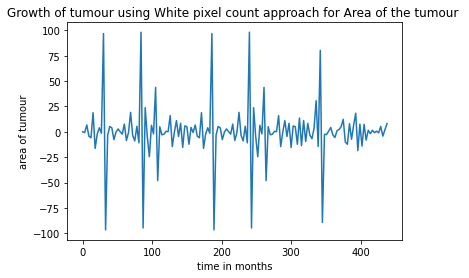

In [94]:
x = np.arange(0,441, 3)
y = df['diff_area_ratio_pred']
plt.xlabel('time in months')
plt.ylabel('area of tumour')
plt.title('Growth of tumour using White pixel count approach for Area of the tumour ')
plt.plot(x, y)

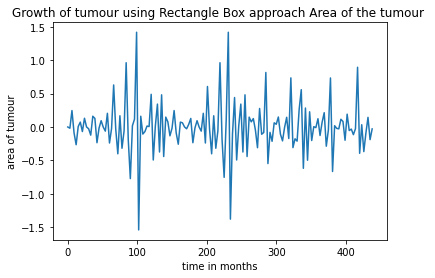

In [95]:
x = np.arange(0,441, 3)
y = df['diff_analysis_recBox']
plt.xlabel('time in months')
plt.ylabel('area of tumour')
plt.title('Growth of tumour using Rectangle Box approach Area of the tumour ')
plt.plot(x, y)

In [96]:
# to find the direction of progression of tumour using rectangle Box approach

In [97]:
df['change in top_left points'] = df['top_left_coor_rec']- df['top_left_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,0.000000,"[nan, nan]"
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539,"[43.0, 3.0]"
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316,"[-31.0, -16.0]"
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545,"[-93.0, 109.0]"
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096,"[40.0, -72.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102,"[31.0, 42.0]"
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789,"[-76.0, 18.0]"
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728,"[119.0, -75.0]"
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766,"[-121.0, -22.0]"


In [98]:
df['change in top_right points'] = df['top_right_coor_rec']- df['top_right_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,0.000000,"[nan, nan]","[nan, nan]"
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539,"[43.0, 3.0]","[26.0, 21.0]"
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316,"[-31.0, -16.0]","[13.0, 6.0]"
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545,"[-93.0, 109.0]","[-122.0, 67.0]"
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096,"[40.0, -72.0]","[-27.0, -72.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102,"[31.0, 42.0]","[-9.0, 42.0]"
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789,"[-76.0, 18.0]","[-131.0, 20.0]"
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728,"[119.0, -75.0]","[176.0, -73.0]"
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766,"[-121.0, -22.0]","[-168.0, -26.0]"


In [99]:
df['change in bottom_right points'] = df['bottom_right_coor_rec']- df['bottom_right_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points,change in bottom_right points
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,0.000000,"[nan, nan]","[nan, nan]","[nan, nan]"
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539,"[43.0, 3.0]","[26.0, 21.0]","[15.0, 20.0]"
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316,"[-31.0, -16.0]","[13.0, 6.0]","[-4.0, 38.0]"
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545,"[-93.0, 109.0]","[-122.0, 67.0]","[-93.0, 80.0]"
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096,"[40.0, -72.0]","[-27.0, -72.0]","[-27.0, -144.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102,"[31.0, 42.0]","[-9.0, 42.0]","[-9.0, -16.0]"
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789,"[-76.0, 18.0]","[-131.0, 20.0]","[-137.0, 42.0]"
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728,"[119.0, -75.0]","[176.0, -73.0]","[178.0, -80.0]"
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766,"[-121.0, -22.0]","[-168.0, -26.0]","[-164.0, -69.0]"


In [100]:
df['change in bottom_left points'] = df['bottom_left_coor_rec']- df['bottom_left_coor_rec'].shift()
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points,change in bottom_right points,change in bottom_left points
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,0.000000,"[nan, nan]","[nan, nan]","[nan, nan]","[nan, nan]"
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539,"[43.0, 3.0]","[26.0, 21.0]","[15.0, 20.0]","[32.0, 4.0]"
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316,"[-31.0, -16.0]","[13.0, 6.0]","[-4.0, 38.0]","[-47.0, 14.0]"
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545,"[-93.0, 109.0]","[-122.0, 67.0]","[-93.0, 80.0]","[-65.0, 123.0]"
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096,"[40.0, -72.0]","[-27.0, -72.0]","[-27.0, -144.0]","[40.0, -144.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102,"[31.0, 42.0]","[-9.0, 42.0]","[-9.0, -16.0]","[31.0, -16.0]"
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789,"[-76.0, 18.0]","[-131.0, 20.0]","[-137.0, 42.0]","[-83.0, 40.0]"
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728,"[119.0, -75.0]","[176.0, -73.0]","[178.0, -80.0]","[123.0, -82.0]"
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766,"[-121.0, -22.0]","[-168.0, -26.0]","[-164.0, -69.0]","[-118.0, -65.0]"


In [101]:
df.loc[0,'change in top_left points']=np.zeros([2,1])

In [102]:
df.loc[0,'change in top_right points']=np.zeros([2,1])

In [103]:
df.loc[0,'change in bottom_right points']=np.zeros([2,1])

In [104]:
df.loc[0,'change in bottom_left points']=np.zeros([2,1])

In [105]:
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,Area_recBox,diff_analysis_recBox,change in top_left points,change in top_right points,change in bottom_right points,change in bottom_left points
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,0.133193,0.000000,"[0.0, 0.0]","[0.0, 0.0]","[0.0, 0.0]","[0.0, 0.0]"
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,0.114653,-0.018539,"[43.0, 3.0]","[26.0, 21.0]","[15.0, 20.0]","[32.0, 4.0]"
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,0.360969,0.246316,"[-31.0, -16.0]","[13.0, 6.0]","[-4.0, 38.0]","[-47.0, 14.0]"
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,0.272425,-0.088545,"[-93.0, 109.0]","[-122.0, 67.0]","[-93.0, 80.0]","[-65.0, 123.0]"
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,0.006329,-0.266096,"[40.0, -72.0]","[-27.0, -72.0]","[-27.0, -144.0]","[40.0, -144.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,0.170879,-0.369102,"[31.0, 42.0]","[-9.0, 42.0]","[-9.0, -16.0]","[31.0, -16.0]"
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,0.080090,-0.090789,"[-76.0, 18.0]","[-131.0, 20.0]","[-137.0, 42.0]","[-83.0, 40.0]"
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,0.224818,0.144728,"[119.0, -75.0]","[176.0, -73.0]","[178.0, -80.0]","[123.0, -82.0]"
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,0.035052,-0.189766,"[-121.0, -22.0]","[-168.0, -26.0]","[-164.0, -69.0]","[-118.0, -65.0]"


In [106]:
x_tl=[]
y_tl=[]
for i in range (0, df.shape[0]):
    x_tl.append(df['change in top_left points'][i][0])
    y_tl.append(df['change in top_left points'][i][1])

In [107]:
x_tr=[]
y_tr=[]
for i in range (0, df.shape[0]):
    x_tr.append(df['change in top_right points'][i][0])
    y_tr.append(df['change in top_right points'][i][1])

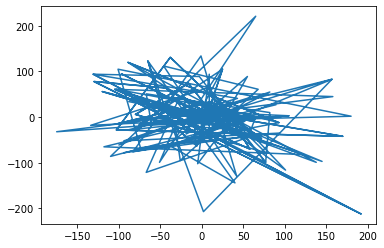

In [108]:
x_bl=[]
y_bl=[]
for i in range (0, df.shape[0]):
    x_bl.append(df['change in bottom_left points'][i][0])
    y_bl.append(df['change in bottom_left points'][i][1])
plt.plot(x_bl,y_bl)

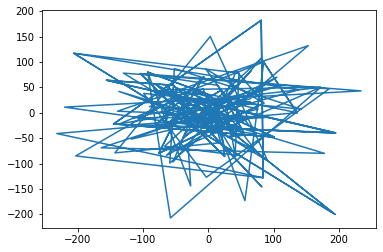

In [109]:
x_br=[]
y_br=[]
for i in range (0, df.shape[0]):
    x_br.append(df['change in bottom_right points'][i][0])
    y_br.append(df['change in bottom_right points'][i][1])
plt.plot(x_br,y_br)

In [110]:
df['x_tl'] = x_tl
df['y_tl'] = y_tl
df['x_tr'] = x_tr
df['y_tr'] = y_tr
df['x_br'] = x_br
df['y_br'] = y_br
df['x_bl'] = x_bl
df['y_bl'] = y_bl
df

,index,white_pixel_area_ratio_mask,white_pixel_area_ratio_pred_mask,length_recBox,width_recBox,top_right_coor_rec,top_left_coor_rec,bottom_right_coor_rec,bottom_left_coor_rec,diff_area_ratio_pred,...,change in bottom_right points,change in bottom_left points,x_tl,y_tl,x_tr,y_tr,x_br,y_br,x_bl,y_bl
0,0,0.212097,4.375000,0.258040,0.516169,"[162.0, 46.0]","[81.0, 44.0]","[161.0, 87.0]","[80.0, 84.0]",0.000000,...,"[0.0, 0.0]","[0.0, 0.0]",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,3.805542,3.672521,0.269047,0.426145,"[188.0, 67.0]","[124.0, 47.0]","[176.0, 107.0]","[112.0, 88.0]",-0.702479,...,"[15.0, 20.0]","[32.0, 4.0]",43.0,3.0,26.0,21.0,15.0,20.0,32.0,4.0
2,2,13.421631,10.437328,0.490260,0.736282,"[201.0, 73.0]","[93.0, 31.0]","[172.0, 145.0]","[65.0, 102.0]",6.764807,...,"[-4.0, 38.0]","[-47.0, 14.0]",-31.0,-16.0,13.0,6.0,-4.0,38.0,-47.0,14.0
3,3,0.546265,6.101928,0.541401,0.503185,"[79.0, 140.0]","[0.0, 140.0]","[79.0, 225.0]","[0.0, 225.0]",-4.335399,...,"[-93.0, 80.0]","[-65.0, 123.0]",-93.0,109.0,-122.0,67.0,-93.0,80.0,-65.0,123.0
4,4,1.419067,0.211777,0.082803,0.076433,"[52.0, 68.0]","[40.0, 68.0]","[52.0, 81.0]","[40.0, 81.0]",-5.890152,...,"[-27.0, -144.0]","[40.0, -144.0]",40.0,-72.0,-27.0,-72.0,-27.0,-144.0,40.0,-144.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,90,0.607300,0.499311,0.331210,0.515924,"[166.0, 79.0]","[85.0, 79.0]","[166.0, 131.0]","[85.0, 131.0]",-0.962466,...,"[-9.0, -16.0]","[31.0, -16.0]",31.0,42.0,-9.0,42.0,-9.0,-16.0,31.0,-16.0
143,91,5.661011,5.819559,0.473152,0.169270,"[35.0, 99.0]","[9.0, 97.0]","[29.0, 173.0]","[2.0, 171.0]",5.320248,...,"[-137.0, 42.0]","[-83.0, 40.0]",-76.0,18.0,-131.0,20.0,-137.0,42.0,-83.0,40.0
144,92,1.959229,1.609848,0.427333,0.526095,"[211.0, 26.0]","[128.0, 22.0]","[207.0, 93.0]","[125.0, 89.0]",-4.209711,...,"[178.0, -80.0]","[123.0, -82.0]",119.0,-75.0,176.0,-73.0,178.0,-80.0,123.0,-82.0
145,93,4.046631,3.443526,0.152866,0.229299,"[43.0, 0.0]","[7.0, 0.0]","[43.0, 24.0]","[7.0, 24.0]",1.833678,...,"[-164.0, -69.0]","[-118.0, -65.0]",-121.0,-22.0,-168.0,-26.0,-164.0,-69.0,-118.0,-65.0


In [111]:
# VIsualization of the direction of progression of coordinates

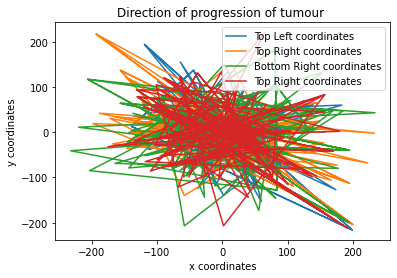

In [112]:
import matplotlib.pyplot as plt

plt.plot(x_tl, y_tl, label = "Top Left coordinates")
plt.plot(x_tr, y_tr, label = "Top Right coordinates")
plt.plot(x_br, y_br, label = "Bottom Right coordinates")
plt.plot(x_bl, y_bl, label = "Top Right coordinates")
plt.xlabel('x coordinates')
# Set the y axis label of the current axis.
plt.ylabel('y coordinates')
# Set a title of the current axes.
plt.title('Direction of progression of tumour ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

**Refernces**<br>
* https://medium.com/ai-salon/understanding-dice-loss-for-crisp-boundary-detection-bb30c2e5f62b
* https://machinelearningmastery.com/how-to-configure-image-data-augmentation-when-training-deep-learning-neural-networks/#:~:text=Image%20data%20augmentation%20is%20a,of%20images%20in%20the%20dataset.
* https://www.section.io/engineering-education/image-preprocessing-in-python/#:~:text=In%20this%20tutorial%2C%20we%20shall,used%20to%20preprocess%20image%20data.
* https://towardsdatascience.com/understanding-semantic-segmentation-with-unet-6be4f42d4b47
